In [64]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import re
import h5py
import seaborn as sns
import mp_utils as mp
import importlib
import librosa
import random
import soundfile as sf
import matplotlib.cm as cm
import matplotlib.gridspec as gridspec
from scipy.signal import spectrogram
from matplotlib.colors import Normalize
from collections import defaultdict
from scipy.stats import entropy
from tqdm import tqdm
from scipy import stats    
from matplotlib.colors import LinearSegmentedColormap
import csv
import umap.umap_ as umap
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score

plt.style.use('seaborn-v0_8')
sns.set_theme(style='whitegrid')
importlib.reload(mp)


<module 'mp_utils' from 'c:\\Users\\alexa\\Documents\\1Alexandra\\delft\\y3\\ResearchProject\\code\\mp_utils.py'>

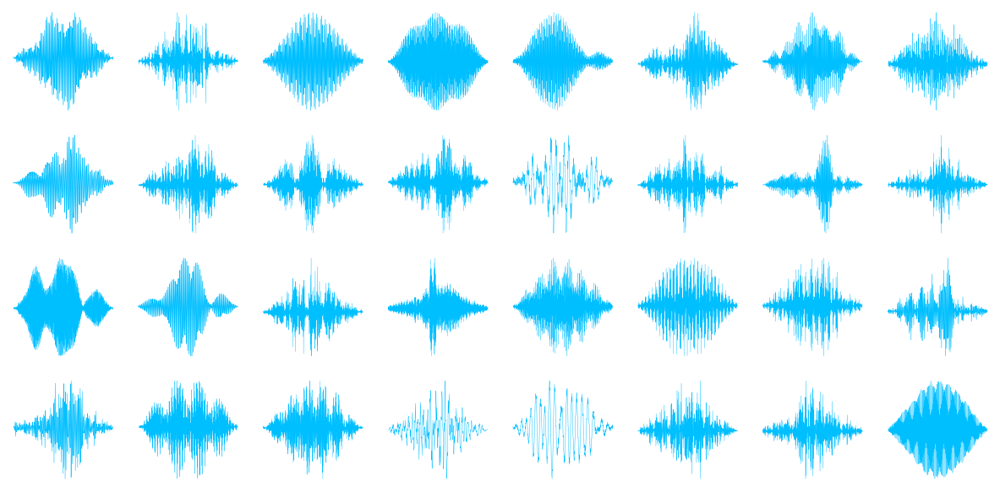

In [67]:
learned_dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
mp.plot_dictionary_elements(learned_dictionary)

In [60]:
def plot_kernels_with_activation(dictionary, activation_counts, num_files, max_kernels=32, cluster=None):
    def clipped_colormap(base_cmap, minval=0.1, maxval=0.95, n=256):
        new_colors = base_cmap(np.linspace(minval, maxval, n))
        return LinearSegmentedColormap.from_list(f"{base_cmap.name}_clipped", new_colors)

    cmap = clipped_colormap(plt.cm.plasma)
    activation_counts = np.array(activation_counts)
    normalized_activations = activation_counts / activation_counts.max()
    colors = cmap(normalized_activations)
    sorted_indices = np.argsort(-activation_counts)
    sorted_dictionary = [dictionary[i] for i in sorted_indices]
    sorted_colors = colors[sorted_indices]
    sorted_activation_counts = activation_counts[sorted_indices]

    # Convert counts to thousands for plotting
    sorted_activation_counts_k = sorted_activation_counts / 1000.0

    fig = plt.figure(figsize=(14, 10))
    
    outer_grid = gridspec.GridSpec(2, 1, height_ratios=[3, 1], hspace=0.15)
    
    top_grid = gridspec.GridSpecFromSubplotSpec(1, 2, subplot_spec=outer_grid[0],
                                                width_ratios=[1, 0.015], wspace=0.15)
    main_ax = plt.Subplot(fig, top_grid[0])
    main_ax.grid(False)
    main_ax.axis('off')
    fig.add_subplot(main_ax)
    
    rows = 4
    cols = max_kernels // rows
    inner_grid = gridspec.GridSpecFromSubplotSpec(rows, cols, subplot_spec=top_grid[0], wspace=0.3, hspace=0.3)
    for i in range(min(max_kernels, len(sorted_dictionary))):
        ax = fig.add_subplot(inner_grid[i])
        kernel = sorted_dictionary[i].kernel
        kernel_length = len(kernel)
        ax.plot(kernel, linewidth=100.0/kernel_length, color=sorted_colors[i])
        ax.axis('off')

    cbar_ax = plt.Subplot(fig, top_grid[1])
    norm = plt.Normalize(vmin=activation_counts.min(), vmax=activation_counts.max())
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])

    cbar = fig.colorbar(sm, cax=cbar_ax)
    cbar.set_label("Activation Count (×10³)", fontsize=24)
    
    # Rescale colorbar ticks to thousands
    ticks = cbar.ax.get_yticks()
    cbar.ax.set_yticklabels([f"{tick / 1000:.0f}" for tick in ticks])
    cbar.ax.tick_params(labelsize=22)

    fig.add_subplot(cbar_ax)

    bottom_ax = fig.add_subplot(outer_grid[1])
    bar_positions = np.arange(len(sorted_activation_counts_k)) + 1
    bottom_ax.bar(bar_positions, sorted_activation_counts_k, color=sorted_colors)
    bottom_ax.set_xticks(bar_positions)
    bottom_ax.set_xticklabels(bar_positions, rotation=90, fontsize=22)
    bottom_ax.set_xlabel("Sorted Kernel Index", fontsize=24)
    bottom_ax.set_ylabel("Activation Count (×10³)", fontsize=24)
    bottom_ax.set_title(
        f"Matching Pursuit Activations Across All Echolocation Calls" +
        (f" from Cluster {cluster}" if cluster is not None else ""), fontsize=24)
    bottom_ax.tick_params(axis='y', labelsize=22)
    bottom_ax.grid(True)

    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()


In [39]:
learned_dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")

# Folder with your WAV files
audio_folder = "high_rhinolophus_affinis_segments"
all_files = [f for f in os.listdir(audio_folder) if f.endswith('.wav')]

# Choose a small random subset (e.g., 5 files)
num_files = 100
sampled_files = random.sample(all_files, num_files)

# Track activation count per kernel
kernel_activations = defaultdict(int)

# Parameters
stop_type = "iterations"
stop_condition = 100  # reasonable depth for efficiency

# Process each file
for file in tqdm(sampled_files):
    filepath = os.path.join(audio_folder, file)
    waveform, sr = sf.read(filepath)

    # Normalize waveform
    waveform = waveform.astype(np.float64)
    waveform /= np.max(np.abs(waveform))

    encoded, _ = mp.matching_pursuit(learned_dictionary, waveform, stop_type, stop_condition)

    for dicElement, amp, idx in encoded:
        kernel_activations[dicElement] += 1

# Convert to array for plotting
num_kernels = len(learned_dictionary)
activation_counts = np.zeros(num_kernels)
for i in range(num_kernels):
    activation_counts[i] = kernel_activations[i]

# plot_dictionary_elements_colored_by_activation(learned_dictionary, activation_counts)
plot_kernels_with_activation(learned_dictionary, activation_counts, num_files=num_files)



  2%|▏         | 2/100 [00:03<03:13,  1.97s/it]


KeyboardInterrupt: 

In [40]:
def compute_activations(
    dictionary_path,
    audio_folder,
    num_files,
    stop_type="iterations",
    stop_condition=100
):
    # Load dictionary
    learned_dictionary = mp.create_dictionary_from_JLD2(dictionary_path)

    # Collect WAV files and sample subset
    all_files = [f for f in os.listdir(audio_folder) if f.endswith('.wav')]
    sampled_files = random.sample(all_files, num_files)

    # Track activation count per kernel
    kernel_activations = defaultdict(int)

    # Process each file
    for file in tqdm(sampled_files, desc="Processing files"):
        filepath = os.path.join(audio_folder, file)
        waveform, sr = sf.read(filepath)

        # Normalize waveform
        waveform = waveform.astype(np.float64)
        waveform /= np.max(np.abs(waveform))

        encoded, _ = mp.matching_pursuit(learned_dictionary, waveform, stop_type, stop_condition)

        for dicElement, amp, idx in encoded:
            kernel_activations[dicElement] += 1

    # Convert to array for plotting
    num_kernels = len(learned_dictionary)
    activation_counts = np.zeros(num_kernels)
    for i in range(num_kernels):
        activation_counts[i] = kernel_activations[i]
    return activation_counts


In [ ]:
learned_dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")

audio_folder = "high_rhinolophus_affinis_segments"
all_files = [f for f in os.listdir(audio_folder) if f.endswith('.wav')]

num_files = 6026
sampled_files = all_files

stop_type = "iterations"
stop_condition = 100

num_kernels = len(learned_dictionary)

activation_data = []

for file in tqdm(sampled_files):
    filepath = os.path.join(audio_folder, file)
    waveform, sr = sf.read(filepath)

    waveform = waveform.astype(np.float64)
    waveform /= np.max(np.abs(waveform))

    encoded, _ = mp.matching_pursuit(learned_dictionary, waveform, stop_type, stop_condition)

    # Count activations per kernel for this file
    per_file_activations = np.zeros(num_kernels, dtype=int)
    for dicElement, amp, idx in encoded:
        per_file_activations[dicElement] += 1

    # Append row with filename + activation counts
    activation_data.append([file] + per_file_activations.tolist())

# Save to CSV
csv_path = "kernel_activations_per_file.csv"
with open(csv_path, 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    # Write header
    header = ['filename'] + [f'kernel_{i}' for i in range(num_kernels)]
    writer.writerow(header)
    # Write data rows
    writer.writerows(activation_data)

print(f"Saved kernel activations per file to {csv_path}")
# Chao bubiiiiiiiiiiiii
# Mnogo si te obicham <3
# Nqmam tyrpenie da se pribera i da sme si pak zaedno



100%|██████████| 6026/6026 [9:29:22<00:00,  5.67s/it]   

Saved kernel activations per file to kernel_activations_per_file.csv


In [41]:
def load_activation_counts_from_csv(csv_path):
    with open(csv_path, 'r') as f:
        reader = csv.reader(f)
        header = next(reader)
        num_kernels = len(header) - 1  # subtract 1 for the filename column

        total_counts = np.zeros(num_kernels, dtype=int)

        for row in reader:
            counts = list(map(int, row[1:]))  # skip filename
            total_counts += np.array(counts)

    return total_counts

C:\Users\alexa\AppData\Local\Temp\ipykernel_3344\259982356.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar.ax.set_yticklabels([f"{tick / 1000:.0f}" for tick in ticks])
C:\Users\alexa\AppData\Local\Temp\ipykernel_3344\259982356.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


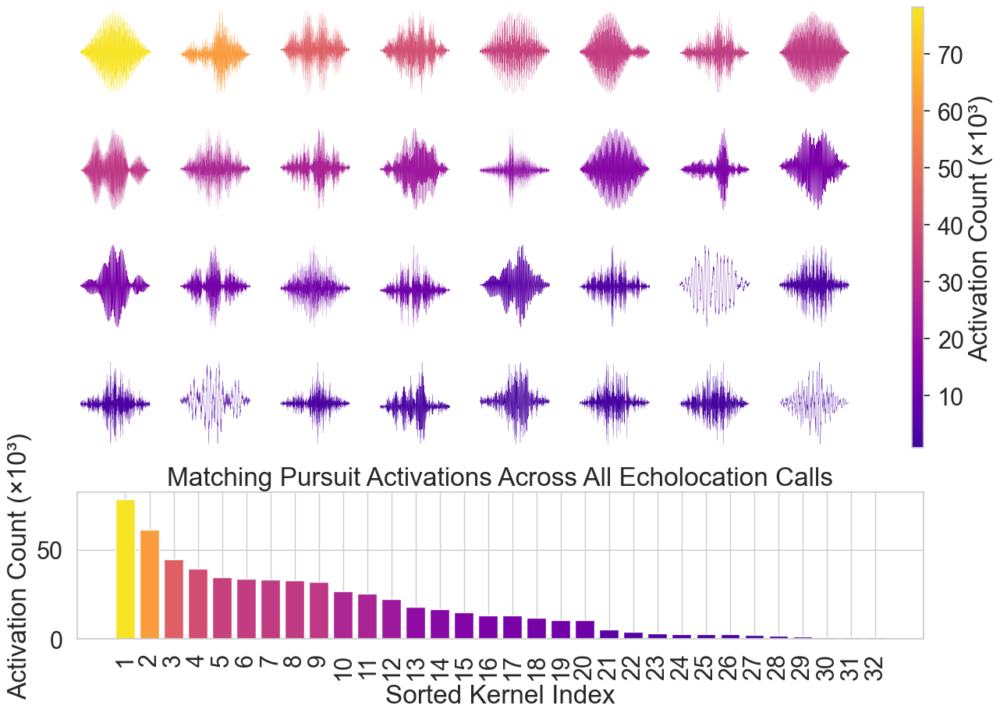

In [61]:
csv_path = "kernel_activations_per_file.csv"
learned_dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
activation_counts = load_activation_counts_from_csv(csv_path)
plot_kernels_with_activation(learned_dictionary, activation_counts, num_files=6026)

In [269]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.colors import LinearSegmentedColormap
from scipy.stats import entropy

def plot_kernels_with_entropy(dictionary, activations_csv_path, max_kernels=32):
    # Load activation matrix and drop filename column
    df = pd.read_csv(activations_csv_path)
    activation_matrix = df.drop(columns=['filename']).values  # shape: [num_files, num_kernels]

    # Transpose to get per-kernel activation distributions across files
    kernel_activations = activation_matrix.T

    # Compute normalized distributions and entropy
    kernel_probs = kernel_activations / (kernel_activations.sum(axis=1, keepdims=True) + 1e-12)
    kernel_entropies = entropy(kernel_probs, base=2, axis=1)

    # Normalize entropy for color mapping
    normalized_entropies = kernel_entropies / kernel_entropies.max()
    cmap = plt.cm.viridis
    colors = cmap(normalized_entropies)

    # Sort kernels by entropy (descending)
    sorted_indices = np.argsort(-kernel_entropies)
    sorted_dictionary = [dictionary[i] for i in sorted_indices]
    sorted_colors = colors[sorted_indices]
    sorted_entropies = kernel_entropies[sorted_indices]

    # Plotting
    fig = plt.figure(figsize=(14, 10))
    fig.suptitle("Kernel Entropy of R. Affinis Echolocation Calls", fontsize=16)

    outer_grid = gridspec.GridSpec(2, 1, height_ratios=[3, 1], hspace=0.15)
    top_grid = gridspec.GridSpecFromSubplotSpec(1, 2, subplot_spec=outer_grid[0], width_ratios=[1, 0.015], wspace=0.15)
    main_ax = plt.Subplot(fig, top_grid[0])
    main_ax.axis('off')
    fig.add_subplot(main_ax)

    rows = 4
    cols = max_kernels // rows
    inner_grid = gridspec.GridSpecFromSubplotSpec(rows, cols, subplot_spec=top_grid[0], wspace=0.3, hspace=0.3)
    for i in range(min(max_kernels, len(sorted_dictionary))):
        ax = fig.add_subplot(inner_grid[i])
        kernel = sorted_dictionary[i].kernel
        kernel_length = len(kernel)
        ax.plot(kernel, linewidth=100.0/kernel_length, color=sorted_colors[i])
        ax.text(0.3, 1, f"Entropy: {sorted_entropies[i]:.2f}", fontsize=8, color='darkblue', transform=ax.transAxes)
        ax.axis('off')

    # Colorbar
    cbar_ax = plt.Subplot(fig, top_grid[1])
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=kernel_entropies.min(), vmax=kernel_entropies.max()))
    sm.set_array([])
    fig.colorbar(sm, cax=cbar_ax).set_label("Entropy (bits)", fontsize=10)
    fig.add_subplot(cbar_ax)

    # Bottom bar plot
    bottom_ax = fig.add_subplot(outer_grid[1])
    bar_positions = np.arange(len(sorted_entropies)) + 1
    bottom_ax.bar(bar_positions, sorted_entropies, color=sorted_colors)
    bottom_ax.set_xticks(bar_positions)
    bottom_ax.set_xticklabels(bar_positions, rotation=90)
    bottom_ax.set_xlabel("Sorted Kernel Index")
    bottom_ax.set_ylabel("Entropy (bits)")
    bottom_ax.set_title("Kernel Entropy Across Files")
    bottom_ax.grid(True)

    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()


C:\Users\alexa\AppData\Local\Temp\ipykernel_19804\1371304385.py:70: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


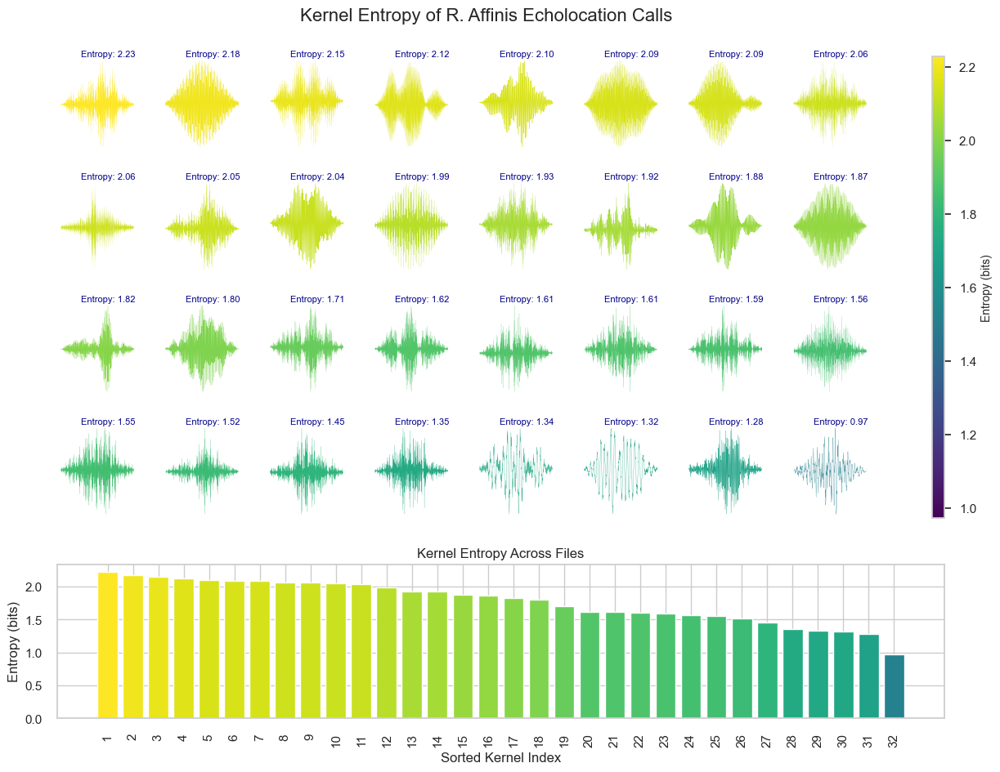

In [268]:
plot_kernels_with_entropy(learned_dictionary, "kernel_activations_per_file.csv")

In [4]:
def matching_pursuit_with_full_tracking(dictionary, x, stop_type, stop_condition):
    """
    Perform matching pursuit with tracking:
      - residuals
      - selected dictionary indices
      - amplitudes
      - time indices

    Parameters:
    - stop_type: "amplitude" or "iterations"
    - stop_condition: float/int depending on stop_type
    """
    x_res = x.copy()
    residuals_list = [x_res.copy()]
    selected_indices = []
    amps = []
    time_idxs = []

    count = 1
    while True:
        x_res, ampMax, indxMax, dicElement = mp.matching_pursuit_iter(dictionary, x_res)
        residuals_list.append(x_res.copy())
        selected_indices.append(dicElement)
        amps.append(ampMax)
        time_idxs.append(indxMax)

        count += 1
        if stop_type == 'amplitude':
            if abs(ampMax) < stop_condition or np.linalg.norm(x_res) < 1e-8:
                break
        elif stop_type == 'iterations':
            if count > stop_condition or np.linalg.norm(x_res) < 1e-8:
                break
        else:
            print("Invalid stop_type. Must be 'amplitude' or 'iterations'.")
            break

    return residuals_list, selected_indices, amps, time_idxs


In [39]:
def plot_mp_iters_spectrogram(
    residuals, selected_dict_indices, amps, time_idxs, dictionary, fs=200000
):
    num_iters = len(selected_dict_indices)

    signal_length = len(residuals[0])
    cumulative_recon = np.zeros(signal_length)

    # fig = plt.figure(figsize=(13, 3 * num_iters))
    # gs = fig.add_gridspec(num_iters, 3, width_ratios=[2, 2, 1])
    fig = plt.figure(figsize=(10, 2.5 * num_iters))
    gs = fig.add_gridspec(num_iters, 3, width_ratios=[2, 2, 1], wspace=0)

    for i in range(num_iters):
        kernel = dictionary[selected_dict_indices[i]].kernel
        amp = amps[i]
        time_idx = time_idxs[i]
        end_idx = min(time_idx + len(kernel), signal_length)

        # Add current atom to cumulative reconstruction
        cumulative_recon[time_idx:end_idx] += amp * kernel[:end_idx - time_idx]

        # Residual spectrogram
        ax_res = fig.add_subplot(gs[i, 0])
        f_res, t_res, Sxx_res = spectrogram(residuals[i], fs=fs, nperseg=128, noverlap=64)
        ax_res.pcolormesh(t_res, f_res / 1000, 10 * np.log10(Sxx_res + 1e-10), shading='gouraud')
        ax_res.set_ylabel(f'Res. {i}')
        ax_res.set_ylim([0, fs // 2000])
        start_time = time_idx / fs
        end_time = end_idx / fs
        ax_res.axvline(start_time, color='white', linestyle='--', alpha=0.6, linewidth=0.8)
        ax_res.axvline(end_time, color='white', linestyle='--', alpha=0.6, linewidth=0.8)
        if i == num_iters - 1:
            ax_res.set_xlabel('Time [s]')
            # ax_res.annotate(
            #         'Frequency [Hz]',
            #         xy=(0, 0.5),
            #         xycoords='axes fraction',
            #         xytext=(-0.15, 0.5),
            #         textcoords='axes fraction',
            #         ha='center', va='center',
            #         rotation=90,
            #         fontsize='medium'
            #     )
            ax_res.text(
                -0.08, -0.22, '[kHz]',
                transform=ax_res.transAxes,
                ha='center', va='center',
                rotation=0,
                fontsize='medium'
            )
        else:
            ax_res.tick_params('x', labelbottom=False)

        # Cumulative reconstruction spectrogram
        ax_recon = fig.add_subplot(gs[i, 1])
        f_rec, t_rec, Sxx_rec = spectrogram(cumulative_recon, fs=fs, nperseg=128, noverlap=64)
        ax_recon.pcolormesh(t_rec, f_rec, 10 * np.log10(Sxx_rec + 1e-10), shading='gouraud')
        if i == num_iters - 1:
            ax_recon.set_xlabel('Time [s]')
        else:
            ax_recon.tick_params('x', labelbottom=False)
        ax_recon.set_ylim([0, fs // 2])
        ax_recon.set_yticks([])
        start_time = time_idx / fs
        end_time = end_idx / fs
        ax_recon.axvline(start_time, color='white', linestyle='--', alpha=0.6, linewidth=0.8)
        ax_recon.axvline(end_time, color='white', linestyle='--', alpha=0.6, linewidth=0.8)


        # Kernel waveform
        ax_kernel = fig.add_subplot(gs[i, 2])
        ax_kernel.plot(kernel, linewidth=150.0/len(kernel), color='purple')
        ax_kernel.set_title(f'Kernel {selected_dict_indices[i] + 1}')
        ax_kernel.tick_params('x', labelbottom=False)
        ax_kernel.set_yticks([])
        ax_kernel.axis('off')

    plt.tight_layout()
    plt.show()


A002531_QEVNMDRKCY_call_44_14.70-14.91s.wav


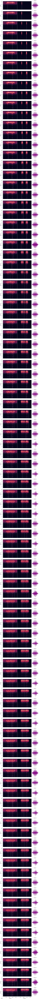

In [43]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
csv_path = "kernel_activations_per_file.csv"
activation_counts = load_activation_counts_from_csv(csv_path)
sorted_indices = np.argsort(-activation_counts)
sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
waveform, sr = sf.read(full_path)
print(filename)
# waveform = waveform.astype(np.float64)
# waveform /= np.max(np.abs(waveform))
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    sorted_dictionary, waveform, stop_type='iterations', stop_condition=100
)

plot_mp_iters_spectrogram(
    residuals=residuals,
    selected_dict_indices=indices,
    amps=amps,
    time_idxs=time_idxs,
    dictionary=sorted_dictionary
)

#A001704_AUAURBYMPI_call_19_3.88-3.97s.wav
#A002099_VDEEZMDGIS_call_6_0.53-0.58s.wav
#A002979_XSHBPHDVZL_call_32_3.47-3.56s.wav
#A000332_JTQFGCATDK_call_25_3.40-3.48s.wav
#A003158_BIJWUEFQKD_call_22_2.21-2.30s.wav
#A000334_HYHRIKYRRR_call_9_0.85-0.94s.wav
#A002125_TRTVOHSVII_call_3_0.29-0.40s.wav
#A002245_JFPLVYMNBF_call_7_0.96-1.05s.wav
#A002287_RQRWPXNJYI_call_11_1.30-1.40s.wav
#A003236_FVPLMGRMVY_call_21_8.99-9.05s.wav
#A003158_BIJWUEFQKD_call_10_0.95-1.02s.wav
#A003285_KKZJHNEDCV_call_16_6.40-6.46s.wav
#A003161_MTQGCLIRVZ_call_34_3.62-3.67s.wav
#A002131_FMVSZSQCFR_call_8_0.68-0.72s.wav

In [146]:
df = pd.read_csv("kernel_activations_per_file.csv")

# Drop the filename column to get just the activation matrix
activation_matrix = df.drop(columns=["filename"]).values  # shape: (6026, 32)

# Transpose to get shape: (32, 6026) — one row per kernel
activation_matrix = activation_matrix.T

# Compute entropy for each kernel
kernel_entropies = []
for acts in activation_matrix:
    # Convert to probability distribution over files
    p = acts / (np.sum(acts) + 1e-10)
    # Shannon entropy (base 2)
    ent = entropy(p, base=2)
    # Normalize by max entropy (uniform over 6026 files)
    ent /= np.log2(activation_matrix.shape[1])
    kernel_entropies.append(ent)

# Display entropy for each kernel
for i, ent in enumerate(kernel_entropies):
    print(f"Kernel {i:02}: Entropy = {ent:.4f}")


Kernel 00: Entropy = 0.8120
Kernel 01: Entropy = 0.5383
Kernel 02: Entropy = 0.8672
Kernel 03: Entropy = 0.8320
Kernel 04: Entropy = 0.8304
Kernel 05: Entropy = 0.8156
Kernel 06: Entropy = 0.7165
Kernel 07: Entropy = 0.6218
Kernel 08: Entropy = 0.8345
Kernel 09: Entropy = 0.8870
Kernel 10: Entropy = 0.6458
Kernel 11: Entropy = 0.6793
Kernel 12: Entropy = 0.5316
Kernel 13: Entropy = 0.6325
Kernel 14: Entropy = 0.7262
Kernel 15: Entropy = 0.6050
Kernel 16: Entropy = 0.8445
Kernel 17: Entropy = 0.7497
Kernel 18: Entropy = 0.6418
Kernel 19: Entropy = 0.8199
Kernel 20: Entropy = 0.8202
Kernel 21: Entropy = 0.7914
Kernel 22: Entropy = 0.6175
Kernel 23: Entropy = 0.7662
Kernel 24: Entropy = 0.5094
Kernel 25: Entropy = 0.8568
Kernel 26: Entropy = 0.7698
Kernel 27: Entropy = 0.3871
Kernel 28: Entropy = 0.5272
Kernel 29: Entropy = 0.6400
Kernel 30: Entropy = 0.5778
Kernel 31: Entropy = 0.7430


In [163]:
def plot_kernels_with_entropy(
    dictionary,
    activations_csv_path=None,
    kernel_entropies=None,
    sorted_indices=None,
    max_kernels=32
):
    # Load activation matrix and compute entropies if not provided
    if kernel_entropies is None or sorted_indices is None:
        if activations_csv_path is None:
            raise ValueError("Either activations_csv_path or both kernel_entropies and sorted_indices must be provided.")
        
        df = pd.read_csv(activations_csv_path)
        activation_matrix = df.drop(columns=['filename']).values
        kernel_activations = activation_matrix.T
        kernel_probs = kernel_activations / (kernel_activations.sum(axis=1, keepdims=True) + 1e-12)
        kernel_entropies = entropy(kernel_probs, base=2, axis=1)
        sorted_indices = np.argsort(-kernel_entropies)

    # Sort kernels and entropies
    sorted_dictionary = [dictionary[i] for i in sorted_indices]
    sorted_entropies = kernel_entropies[sorted_indices]

    # Use actual entropy values for coloring
    cmap = plt.cm.viridis
    norm = plt.Normalize(vmin=0, vmax=1)
    sorted_colors = cmap(norm(sorted_entropies))

    # Plotting
    fig = plt.figure(figsize=(14, 10))
    fig.suptitle("Kernel Entropy of R. Affinis Echolocation Calls", fontsize=16)

    outer_grid = gridspec.GridSpec(2, 1, height_ratios=[3, 1], hspace=0.15)
    top_grid = gridspec.GridSpecFromSubplotSpec(1, 2, subplot_spec=outer_grid[0], width_ratios=[1, 0.015], wspace=0.15)
    main_ax = plt.Subplot(fig, top_grid[0])
    main_ax.axis('off')
    fig.add_subplot(main_ax)

    rows = 4
    cols = max_kernels // rows
    inner_grid = gridspec.GridSpecFromSubplotSpec(rows, cols, subplot_spec=top_grid[0], wspace=0.3, hspace=0.3)

    for i in range(min(max_kernels, len(sorted_dictionary))):
        ax = fig.add_subplot(inner_grid[i])
        kernel = sorted_dictionary[i].kernel
        kernel_length = len(kernel)
        ax.plot(kernel, linewidth=100.0 / kernel_length, color=sorted_colors[i])
        ax.text(0.3, 1, f"Entropy: {sorted_entropies[i]:.2f}", fontsize=8, color='darkblue', transform=ax.transAxes)
        ax.axis('off')

    # Colorbar
    cbar_ax = plt.Subplot(fig, top_grid[1])
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=0, vmax=1))
    sm.set_array([])
    fig.colorbar(sm, cax=cbar_ax).set_label("Entropy (bits)", fontsize=10)
    fig.add_subplot(cbar_ax)

    # Bottom bar plot
    bottom_ax = fig.add_subplot(outer_grid[1])
    bar_positions = np.arange(len(sorted_entropies)) + 1
    bottom_ax.bar(bar_positions, sorted_entropies, color=sorted_colors)
    bottom_ax.set_xticks(bar_positions)
    bottom_ax.set_xticklabels(bar_positions, rotation=90)
    bottom_ax.set_xlabel("Sorted Kernel Index")
    bottom_ax.set_ylabel("Entropy (bits)")
    bottom_ax.set_title("Kernel Entropy Across Files")
    bottom_ax.grid(True)

    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\941532182.py:69: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


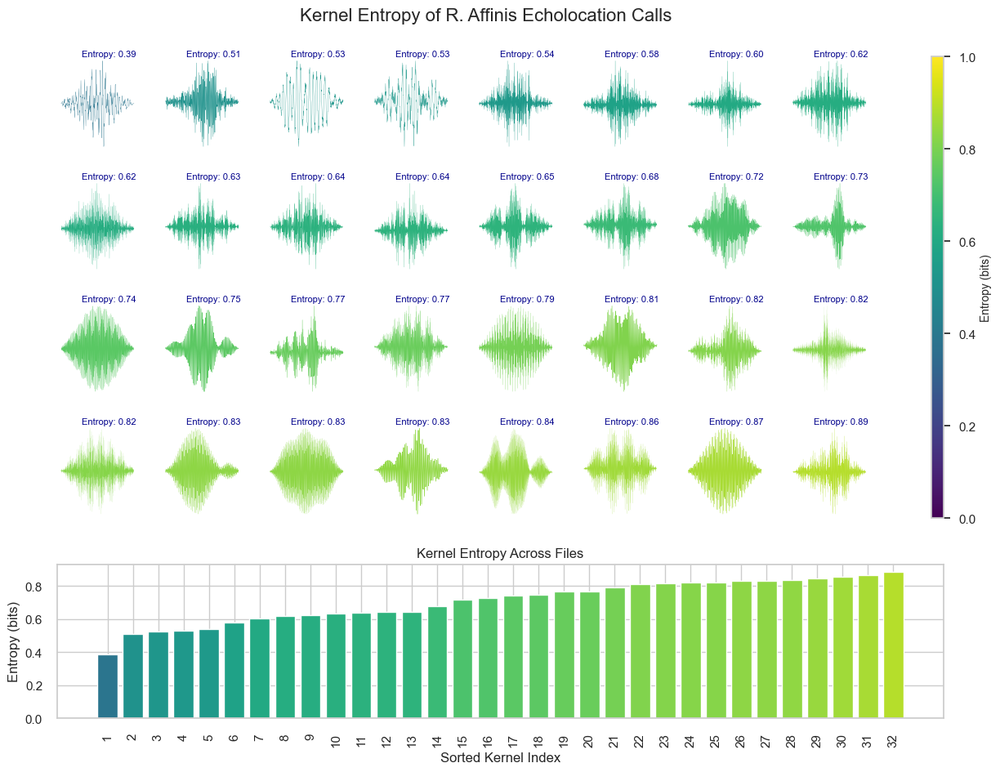

In [164]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
plot_kernels_with_entropy(
    dictionary=dictionary,
    kernel_entropies=np.array(kernel_entropies),
    sorted_indices=np.argsort(np.array(kernel_entropies)),
    max_kernels=32
)

In [321]:
def project_umap(data):
	reducer = umap.UMAP(random_state=42)
	embedding = reducer.fit_transform(data)
	return embedding

In [322]:
def cluster_with_kmeans(data, n_clusters = 16):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(data)
    return labels

In [323]:
df = pd.read_csv("kernel_activations_per_file.csv")
activation_matrix = df.drop(columns=["filename"]).values
embedding = project_umap(activation_matrix)

c:\Users\alexa\Documents\1Alexandra\delft\y3\ResearchProject\code\env\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\alexa\Documents\1Alexandra\delft\y3\ResearchProject\code\env\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [359]:
def plot_clustered(embedding, clusters, type="UMAP"):
    fig, ax = plt.subplots(figsize=(10, 6))

    # Unique clusters for palette
    unique_clusters = np.unique(clusters)
    palette = sns.color_palette("hsv", len(unique_clusters))

    # Plot on the Axes object
    sns.scatterplot(
        x=embedding[:, 0],
        y=embedding[:, 1],
        hue=clusters,
        palette=palette,
        s=2,
        legend="full",
        ax=ax,
        edgecolor='none'
    )

    handles, labels = ax.get_legend_handles_labels()
    legend_labels = [f"Cluster {label}" for label in labels if label.isdigit()]
    handles = handles[-len(legend_labels):]

    ax.legend(
        handles=handles,
        labels=legend_labels,
        title="Cluster ID",
        labelspacing=0.5,
        borderpad=1,
        markerscale=5
    )

    ax.set_title(f"{type} Projection of Kernel Activation Counts Colored by K-Means Clusters")
    ax.set_xlabel(f"{type} Dimension 1")
    ax.set_ylabel(f"{type} Dimension 2")
    plt.tight_layout()
    plt.show()


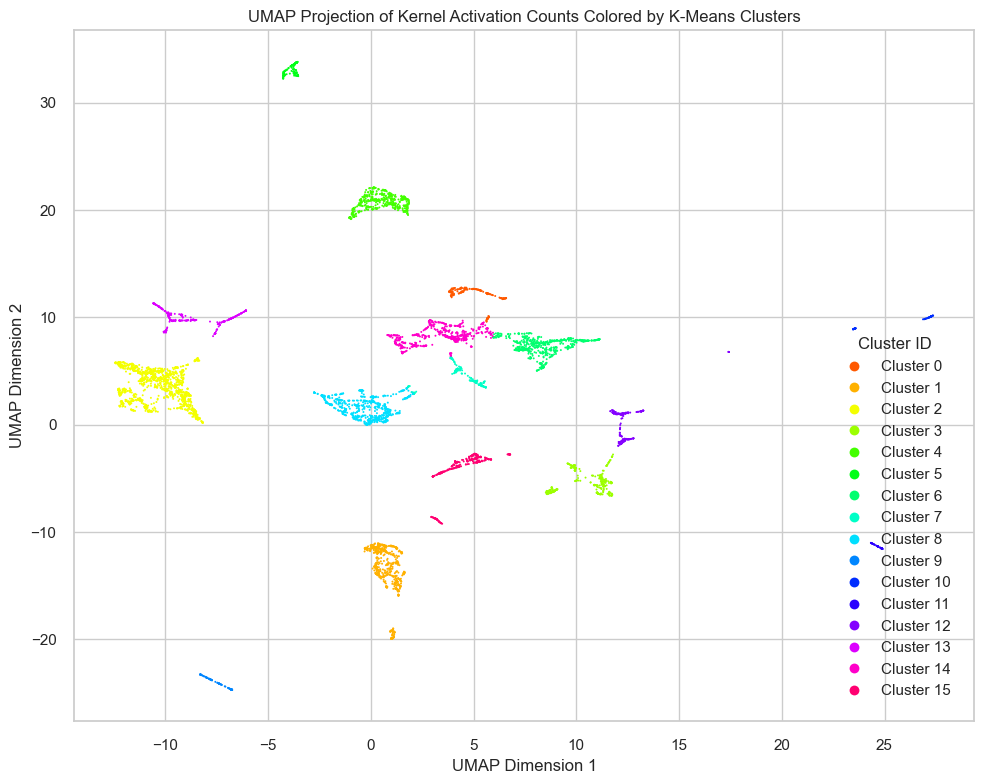

In [346]:
clusters_embedding = cluster_with_kmeans(embedding)
plot_clustered(embedding, clusters_embedding)

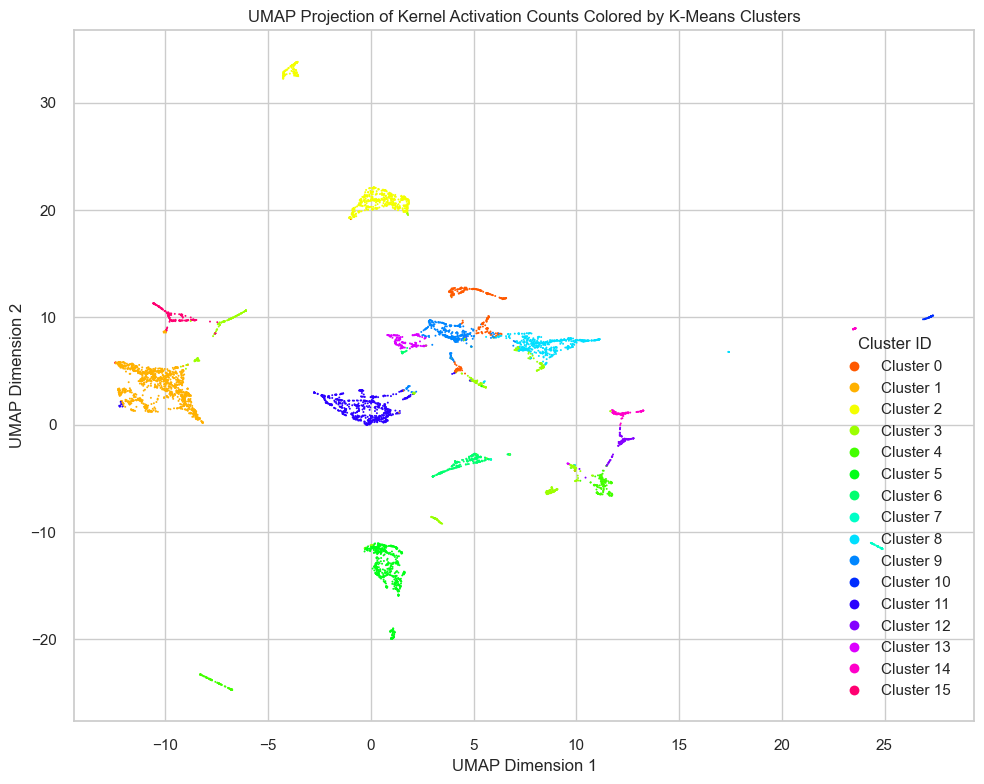

In [347]:
df = pd.read_csv("kernel_activations_per_file.csv")
X = df.drop(columns=["filename"]).values
clusters_raw = cluster_with_kmeans(X)
plot_clustered(embedding, clusters_raw)

In [119]:
def evaluate_elbow_method(data, cluster_range = range(1, 50)):
    inertias = []

    for k in cluster_range:
        kmeans = KMeans(n_clusters=k, random_state=42).fit(data)
        inertias.append(kmeans.inertia_)

    plt.figure()
    plt.plot(cluster_range, inertias, marker='o')
    plt.title("Elbow Method for Optimal k")
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Inertia (Sum of Squared Distances)")
    plt.grid(True)
    plt.show()

    return inertias

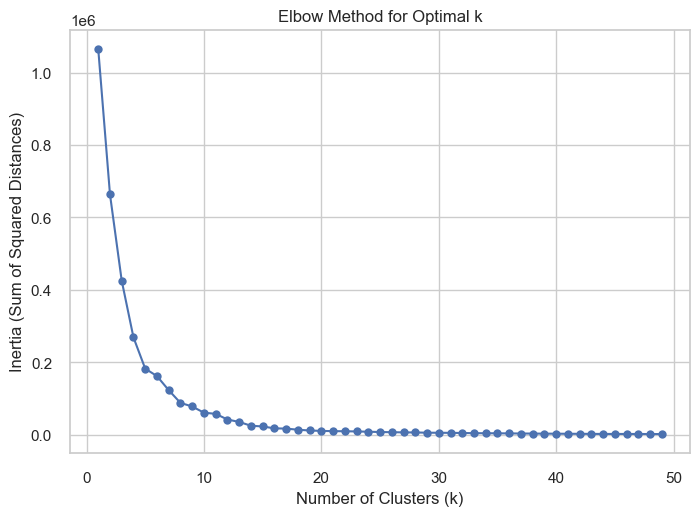

In [328]:
inertias_embedding = evaluate_elbow_method(embedding)

In [120]:
def evaluate_silhouette_scores(data, cluster_range = range(2, 40)):
    silhouette_scores = []

    for k in cluster_range:
        kmeans = KMeans(n_clusters=k, random_state=42).fit(data)
        score = silhouette_score(data, kmeans.labels_)
        silhouette_scores.append(score)
        # print(f"k = {k}: Silhouette Score = {score:.4f}")

    # Plotting
    plt.figure(figsize=(8, 5))
    plt.plot(cluster_range, silhouette_scores, marker='o', color='mediumblue')
    plt.title("Silhouette Score vs. Number of Clusters")
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Silhouette Score")
    plt.grid(True)
    plt.show()

    return silhouette_scores


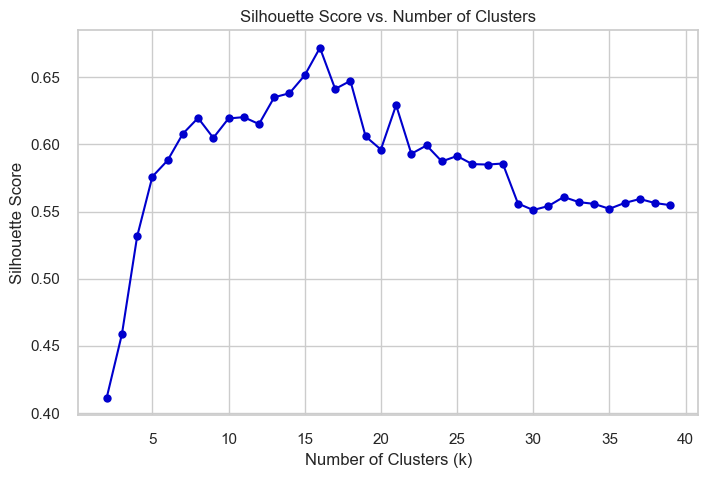

In [275]:
silhouette_scores_embedding = evaluate_silhouette_scores(embedding)

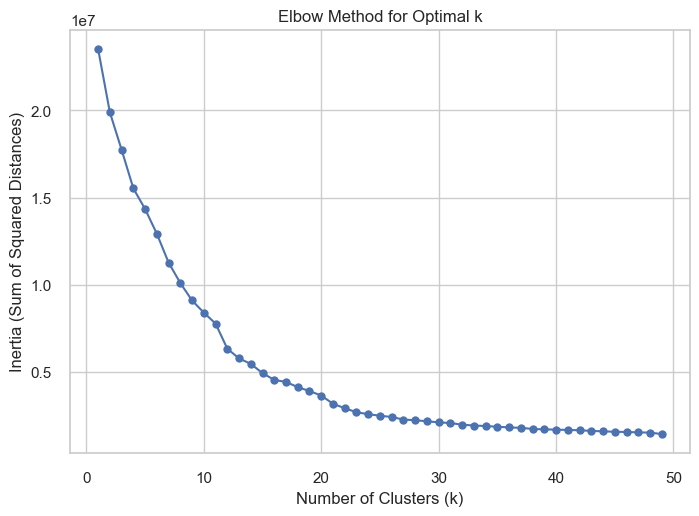

In [277]:
df = pd.read_csv("kernel_activations_per_file.csv")
X = df.drop(columns=["filename"]).values
inertias_raw = evaluate_elbow_method(X)

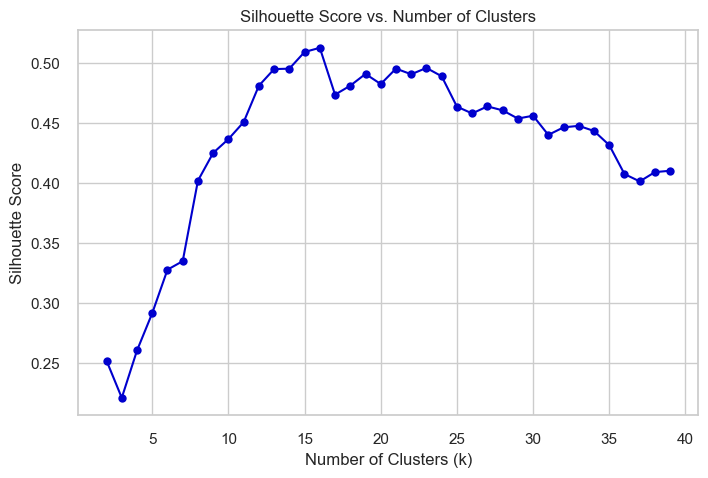

In [276]:
df = pd.read_csv("kernel_activations_per_file.csv")
X = df.drop(columns=["filename"]).values
silhouette_scores_raw = evaluate_silhouette_scores(X)

In [332]:
def add_clusters_to_csv(
    csv_path, 
    clusters,
    name="raw"
):
    # Load data
    df = pd.read_csv(csv_path)

    # Extract activations (drop filename)
    activations = df.drop(columns=["filename"]).values

    # Add cluster labels to dataframe
    df["cluster"] = clusters

    # Build new filename with _clustered suffix before extension
    base, ext = os.path.splitext(csv_path)
    clustered_csv_path = f"{base}_clustered_{name}{ext}"

    # Save new CSV
    df.to_csv(clustered_csv_path, index=False)

    print(f"Clustered CSV saved to: {clustered_csv_path}")
    return clustered_csv_path


In [334]:
new_csv = add_clusters_to_csv("kernel_activations_per_file.csv", clusters_raw)
new_csv = add_clusters_to_csv("kernel_activations_per_file.csv", clusters_embedding, name="embedding")

Clustered CSV saved to: kernel_activations_per_file_clustered_raw.csv
Clustered CSV saved to: kernel_activations_per_file_clustered_embedding.csv


In [ ]:
def plot_kernel_activations_per_cluster(df_clustered):
    # Select numeric columns only (kernel activations), exclude 'cluster' column explicitly
    numeric_cols = [col for col in df_clustered.select_dtypes(include=[float, int]).columns if col != 'cluster']
    
    # Get cluster sizes and sort clusters by size (descending)
    cluster_sizes = df_clustered["cluster"].value_counts().sort_values(ascending=False)
    sorted_clusters = cluster_sizes.index.tolist()
    
    # Reorder dataframe by cluster size
    df_clustered['cluster'] = pd.Categorical(df_clustered['cluster'], categories=sorted_clusters, ordered=True)
    df_clustered = df_clustered.sort_values('cluster')
    
    # Compute mean activation per cluster using only numeric columns
    mean_activations = df_clustered.groupby('cluster')[numeric_cols].mean()
    
    # Normalize activations per cluster for heatmap
    normalized = mean_activations.div(mean_activations.sum(axis=1), axis=0)
    
    # Reindex normalized activations by sorted clusters
    normalized = normalized.loc[sorted_clusters]

    # Compute mean activation per cluster (not normalized)
    mean_activations = df_clustered.groupby('cluster')[numeric_cols].mean()
    # Apply log1p to emphasize differences
    log_activations = np.log1p(mean_activations)
    # Optional: mask very small values (set to NaN for white cells)
    masked = log_activations.mask(log_activations < np.log1p(0.01))
    # Plot with custom colormap
    

    
    # Set up figure and axis
    fig, ax = plt.subplots(figsize=(16, 6))
    sns.heatmap(masked, cmap="Blues", annot=False, fmt=".2f", ax=ax,
        cbar_kws={'label': 'log(1 + Activation Magnitude)'})
#     sns.heatmap(normalized, cmap="viridis", annot=True, fmt=".2f", 
#                 annot_kws={"size": 8}, ax=ax, cbar_kws={'label': 'Normalized Activation'})
    
    # Format x-axis labels as 'kernel 1', 'kernel 2', ...
    new_labels = [f"kernel {int(col.split('_')[-1]) + 1}" for col in numeric_cols]
    ax.set_xticks(np.arange(len(new_labels)) + 0.5)
    ax.set_xticklabels(new_labels, rotation=90, ha='right')
    
    # Set y-axis labels to show cluster numbers (1-based)
    ax.set_yticks(np.arange(len(sorted_clusters)) + 0.5)
    ax.set_yticklabels([f"{c+1}" for c in range(len(sorted_clusters))])
    
    # Add cluster size labels on the right (already sorted)
    yticks = np.arange(len(cluster_sizes)) + 0.5
    for ytick, (cluster, size) in zip(yticks, cluster_sizes.items()):
        ax.text(len(new_labels) + 0.2, ytick, f"{size}", 
                va='center', ha='left', fontsize=10, color='black', weight='bold')
    
    # Add 'Cluster Size' label below all numbers
    ax.text(len(new_labels) + 0.4, len(cluster_sizes) + 1.6, "cluster size", 
            va='center', ha='left', fontsize=10, rotation=90)
    
    # Adjust x-limits to fit text
    ax.set_xlim(0, len(new_labels) + 1)
    
    # Final labels
    ax.set_title("Normalized Kernel Activations per Cluster (Sorted by Size)")
    ax.set_xlabel("Kernel Index")
    ax.set_ylabel("Cluster")
    ax.grid('off')
    plt.grid('off')
    plt.tight_layout()
    plt.show()

In [106]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_kernel_dotplot(df_clustered):
    # Identify kernel columns (exclude 'filename' and 'cluster')
    kernel_cols = [col for col in df_clustered.columns if col.startswith("kernel_")]

    # Ensure 'cluster' is treated as categorical, ordered by size
    cluster_sizes = df_clustered['cluster'].value_counts().sort_values(ascending=False)
    sorted_clusters = cluster_sizes.index.tolist()
    df_clustered['cluster'] = pd.Categorical(df_clustered['cluster'], categories=sorted_clusters, ordered=True)

    # Compute mean absolute activation (amplitude) and usage frequency
    amplitude_df = df_clustered.groupby('cluster')[kernel_cols].mean().abs()
    usage_df = df_clustered[kernel_cols].gt(0).groupby(df_clustered['cluster']).mean()

    # Prepare long-form DataFrame for plotting
    data = []
    for cluster in sorted_clusters:
        for kernel in kernel_cols:
            amplitude = amplitude_df.loc[cluster, kernel]
            usage = usage_df.loc[cluster, kernel]
            data.append({
                'cluster': cluster,
                'kernel': kernel,
                'amplitude': amplitude,
                'usage': usage
            })

    df_plot = pd.DataFrame(data)
    df_plot['kernel_idx'] = df_plot['kernel'].apply(lambda x: int(x.split('_')[-1]))
    df_plot['cluster_idx'] = df_plot['cluster'].astype(int) + 1  # convert to int for y-axis

    # Plot
    plt.figure(figsize=(18, 8))
    scatter = plt.scatter(
        x=df_plot['kernel_idx'], 
        y=df_plot['cluster_idx'],
        s=df_plot['amplitude'] * 50,   # scale dot size
        c=df_plot['usage'], 
        cmap='viridis', 
        alpha=0.8, 
        edgecolor='black',
        linewidth=0.5
    )

    plt.xlabel('Kernel Index')
    plt.ylabel('Cluster')
    plt.title('Kernel Activations per Cluster\n(Dot Size = Amplitude, Color = Usage Frequency)')
    plt.colorbar(scatter, label='Kernel Usage Frequency')

    # Format axes
    plt.xticks(ticks=np.arange(len(kernel_cols)), labels=[f'k{i+1}' for i in range(len(kernel_cols))], rotation=90)
    plt.yticks(ticks=np.arange(1, len(sorted_clusters)+1), labels=[f'Cluster {i}' for i in range(1, len(sorted_clusters)+1)])

    plt.tight_layout()
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.show()


Plotting activations for Cluster 1 (n=1163)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


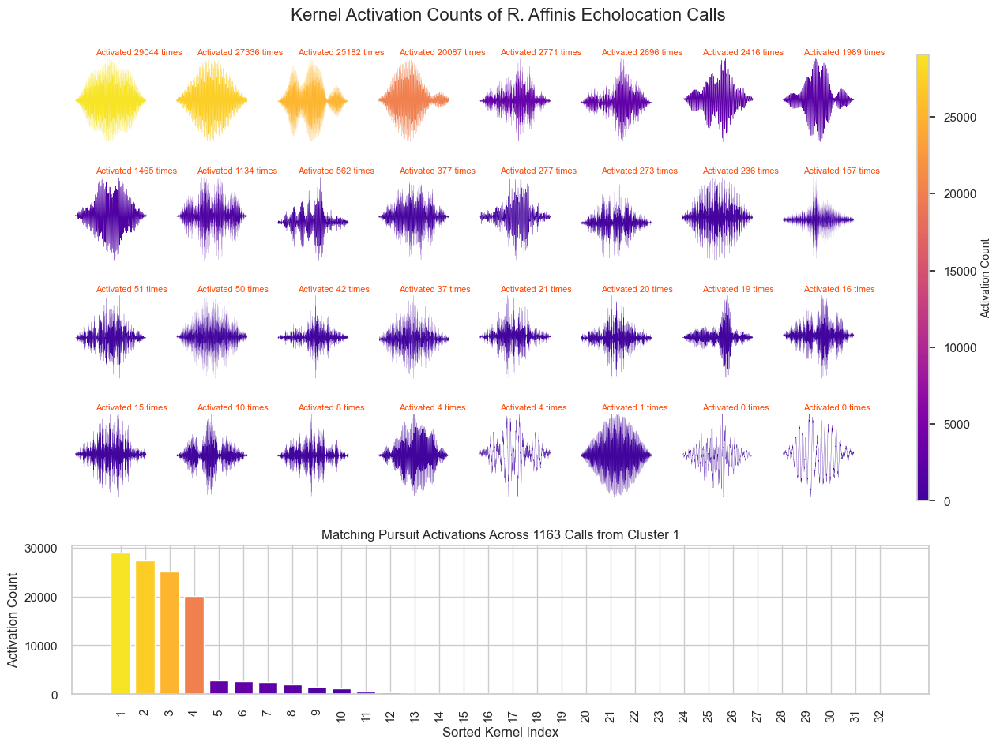

Plotting activations for Cluster 11 (n=660)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


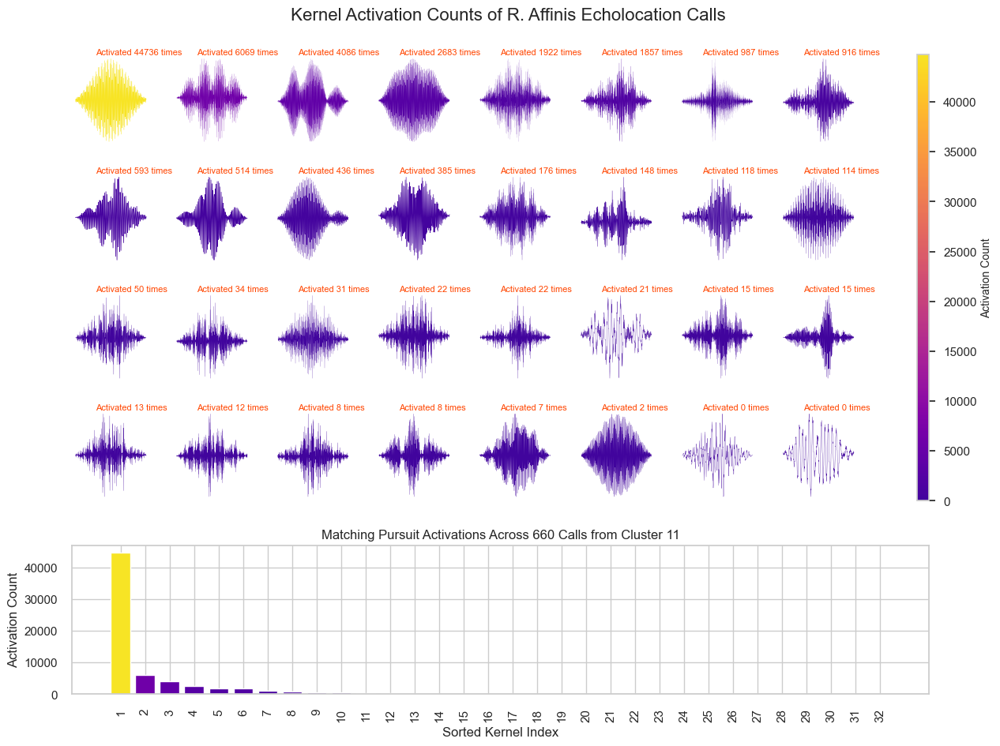

Plotting activations for Cluster 2 (n=653)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


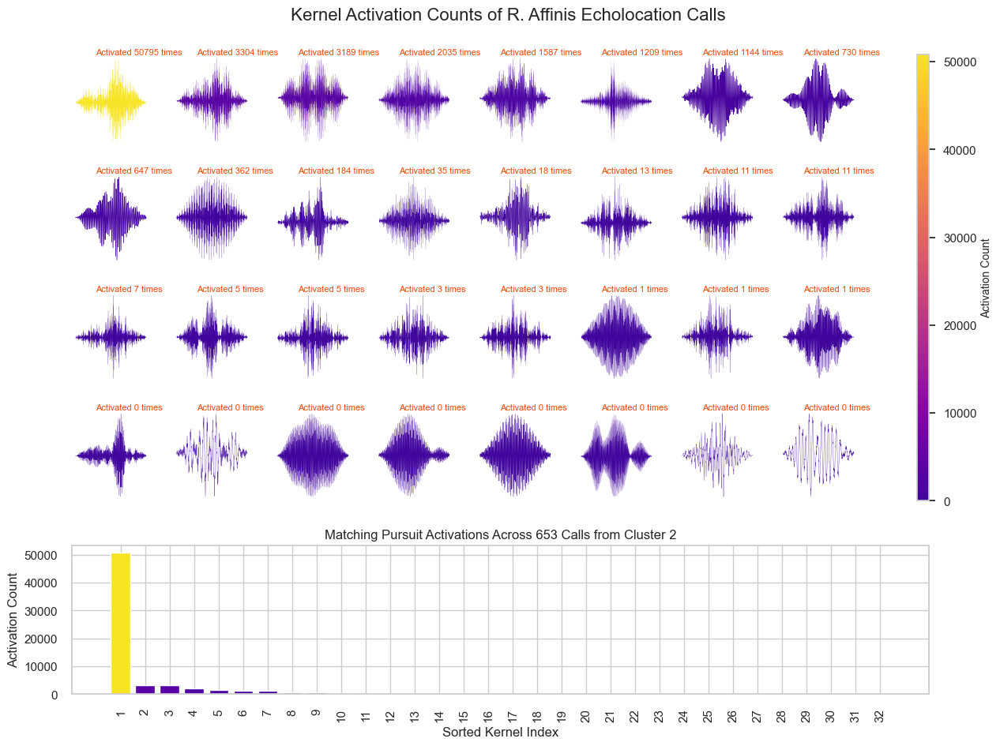

Plotting activations for Cluster 5 (n=575)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


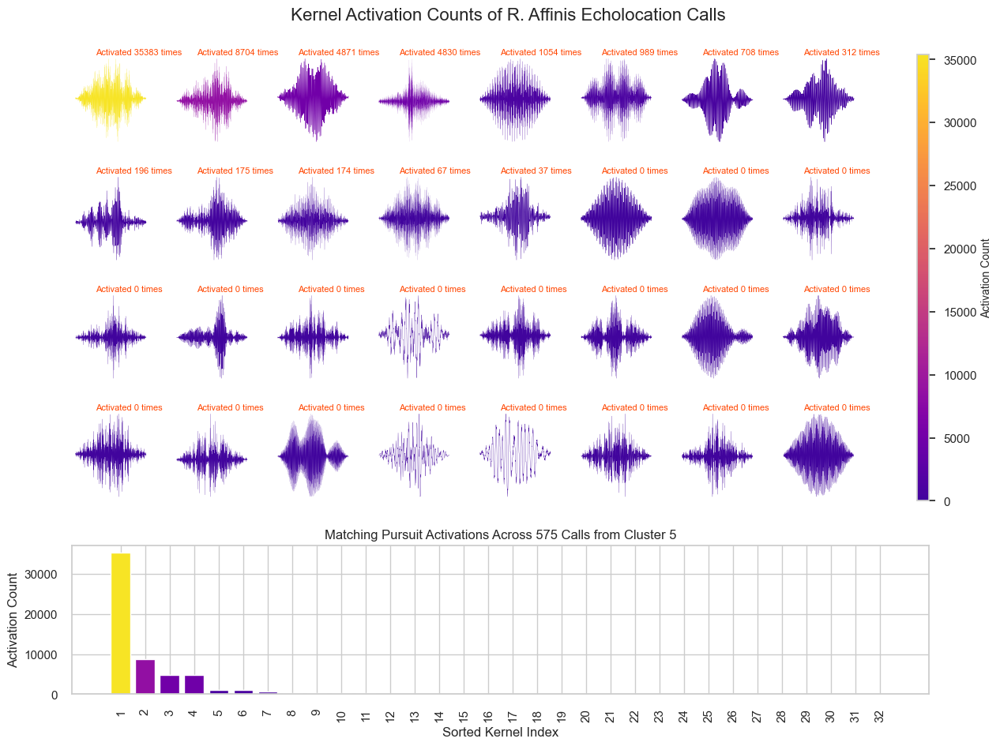

Plotting activations for Cluster 3 (n=542)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


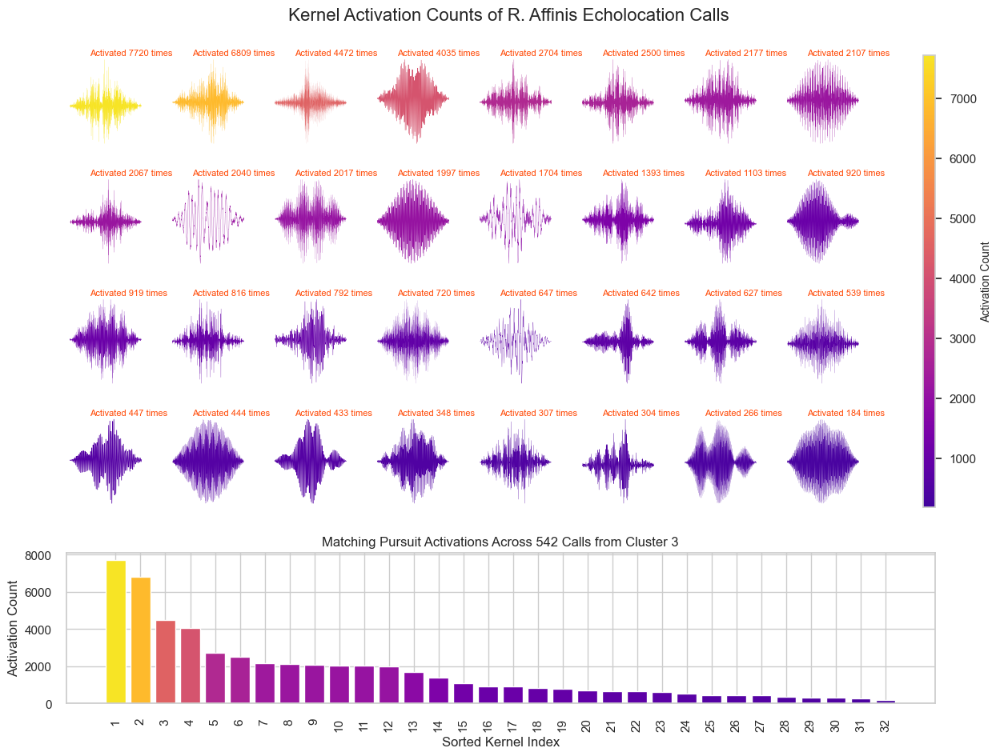

Plotting activations for Cluster 8 (n=514)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


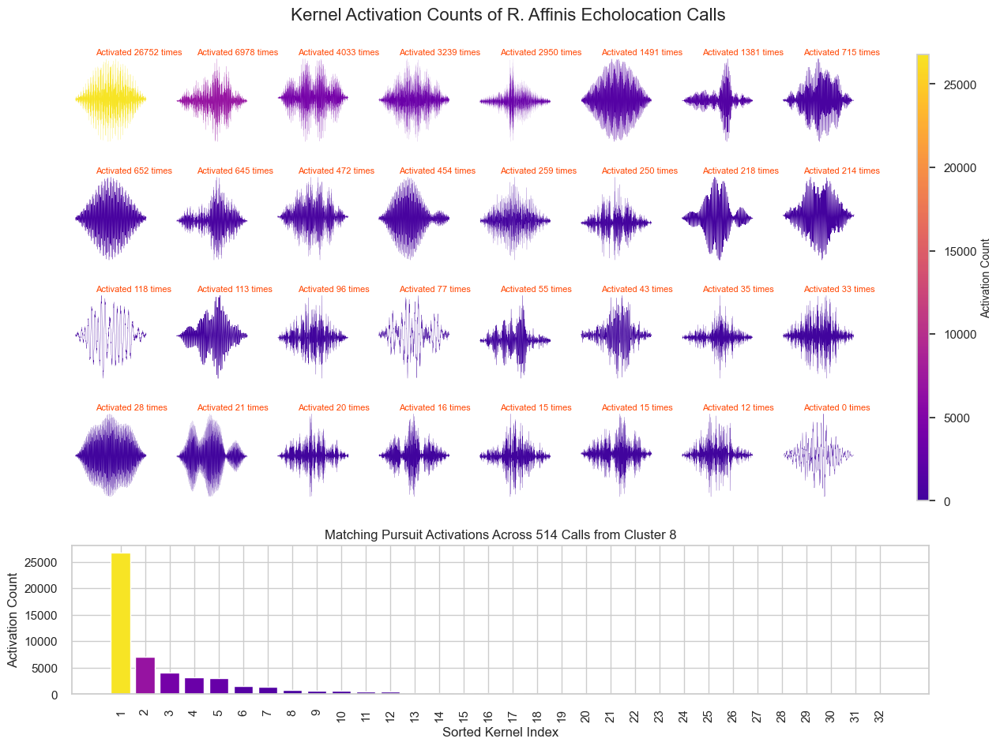

Plotting activations for Cluster 9 (n=362)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


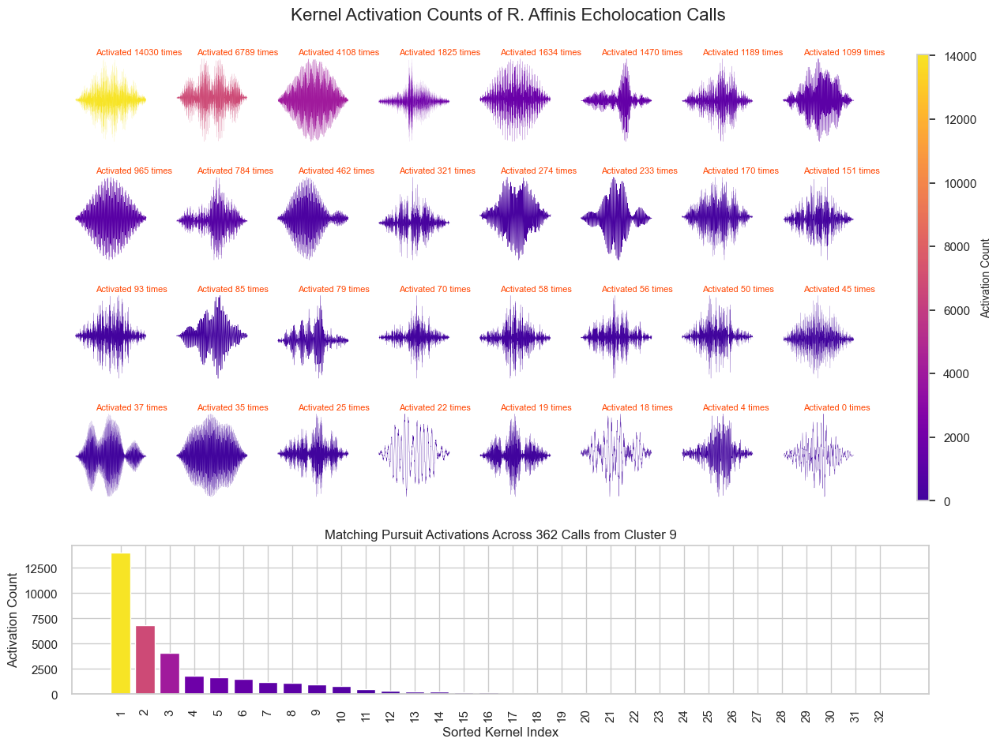

Plotting activations for Cluster 0 (n=306)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


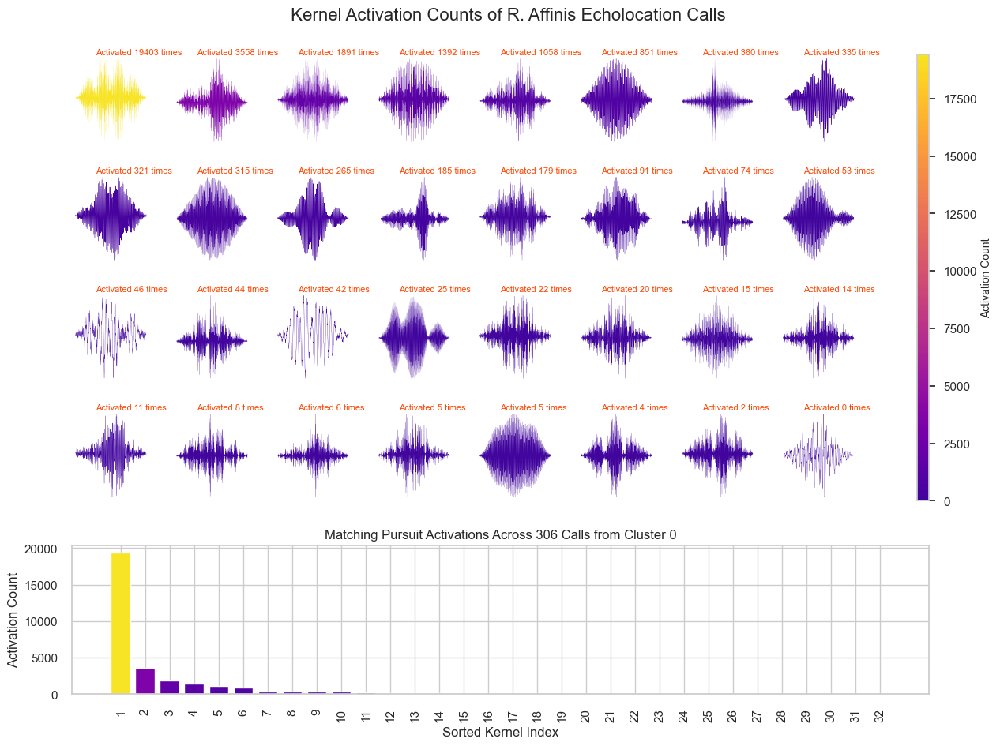

Plotting activations for Cluster 4 (n=274)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


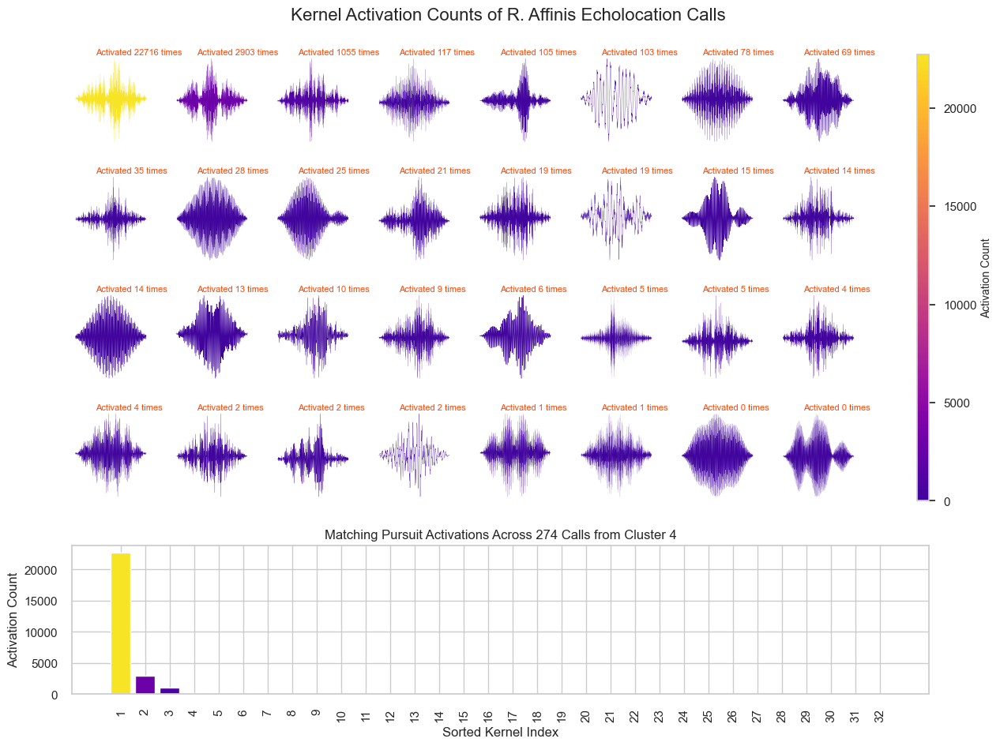

Plotting activations for Cluster 6 (n=262)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


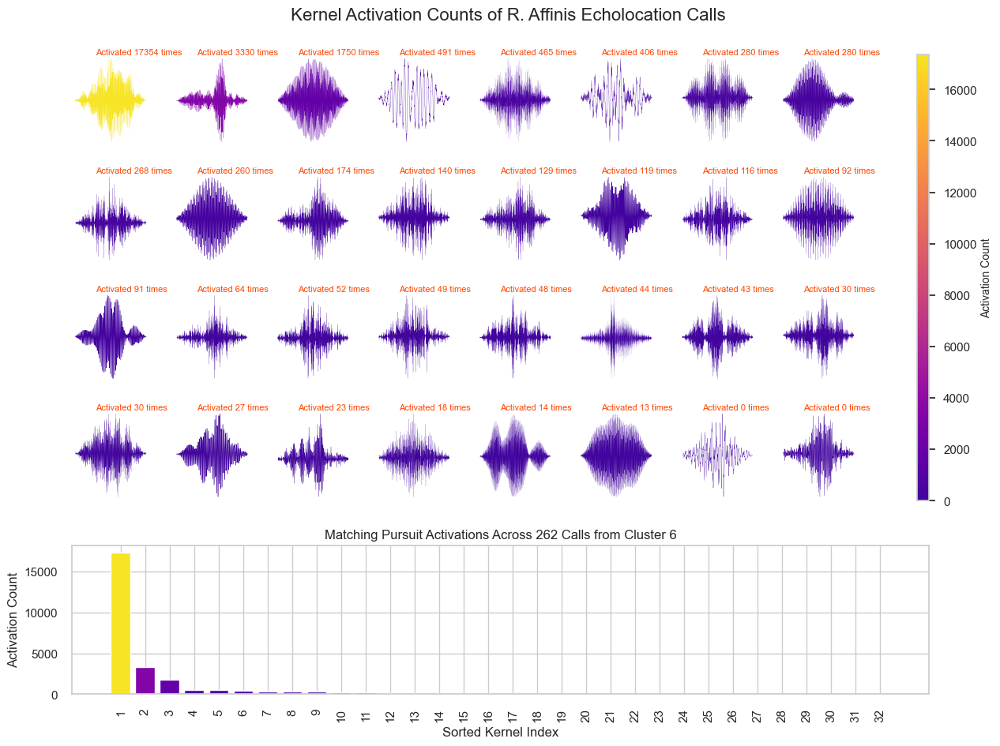

Plotting activations for Cluster 15 (n=180)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


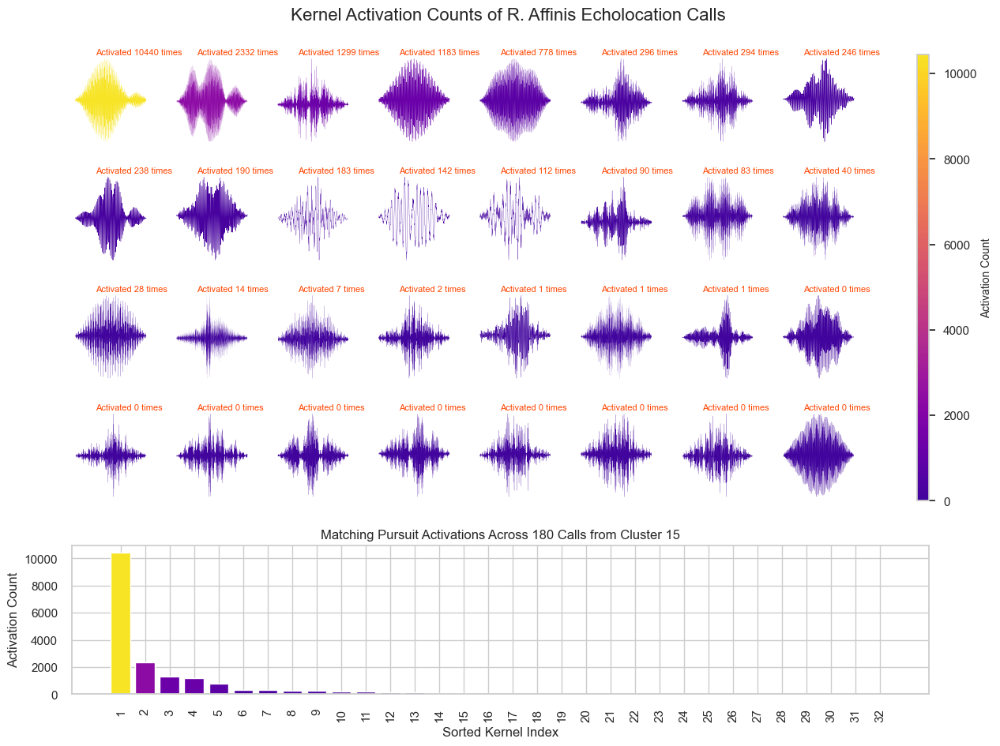

Plotting activations for Cluster 13 (n=161)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


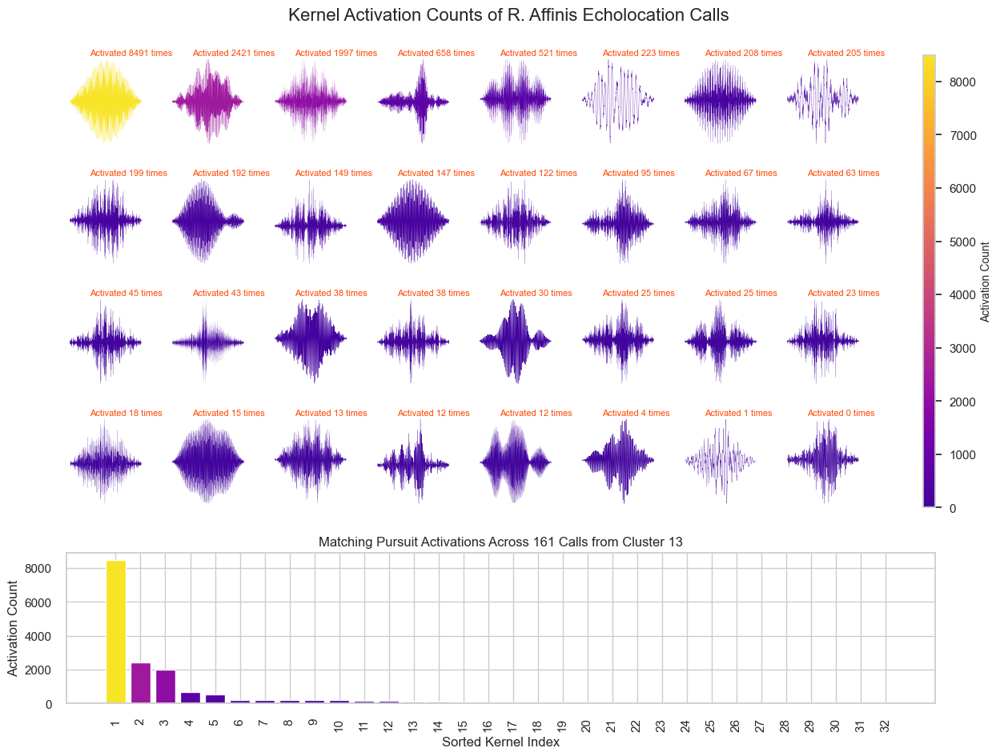

Plotting activations for Cluster 14 (n=129)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


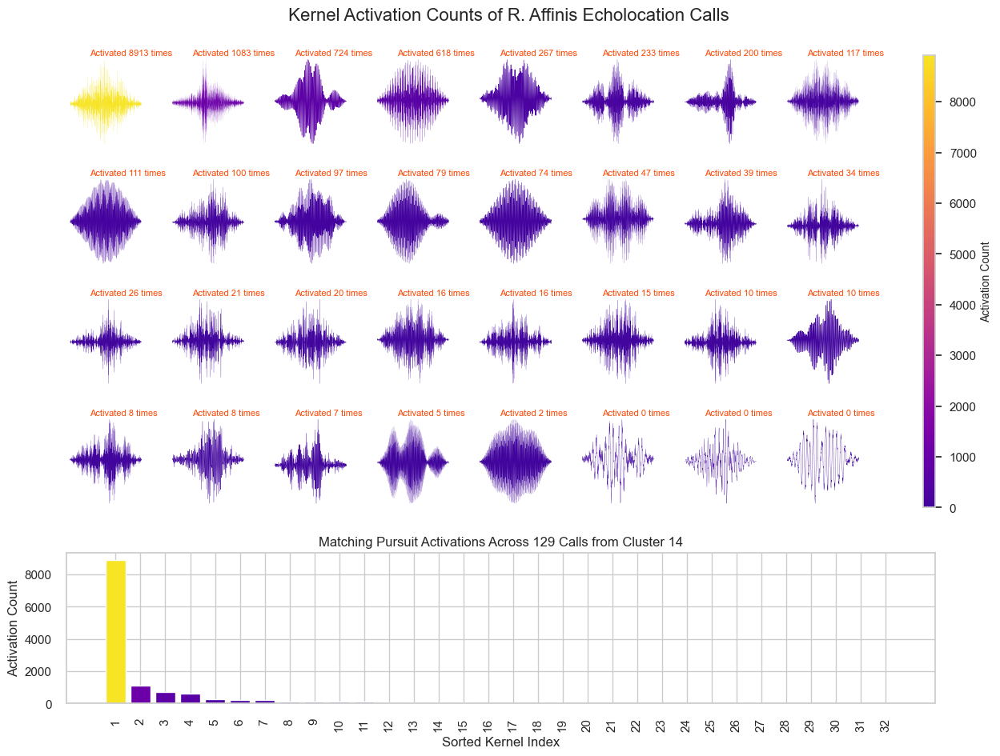

Plotting activations for Cluster 12 (n=101)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


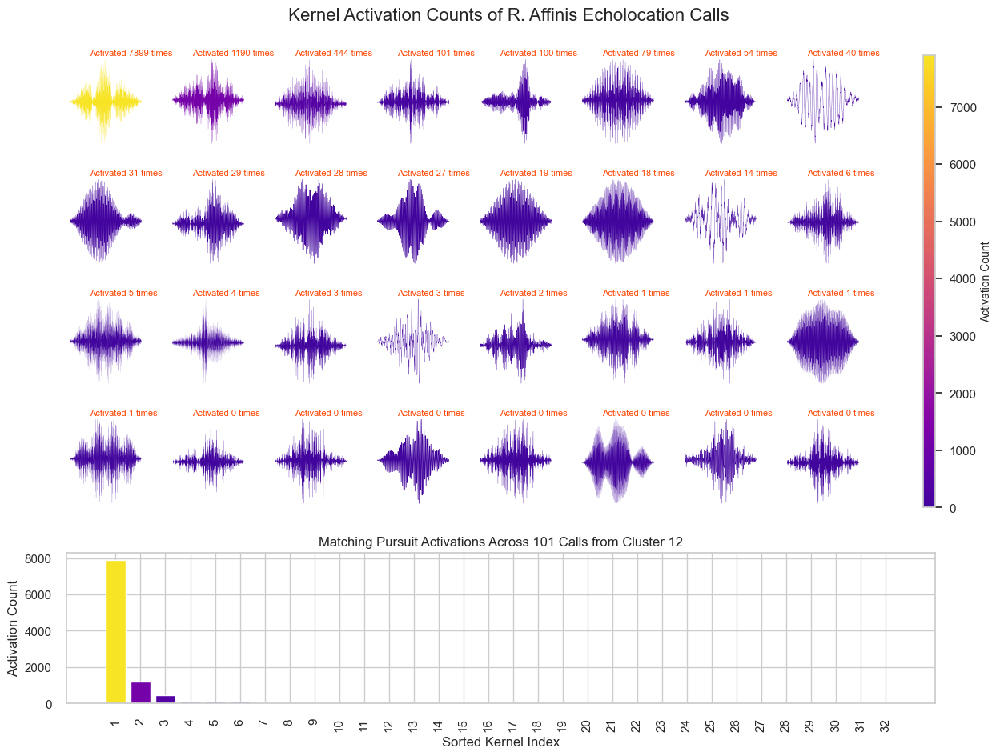

Plotting activations for Cluster 10 (n=72)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


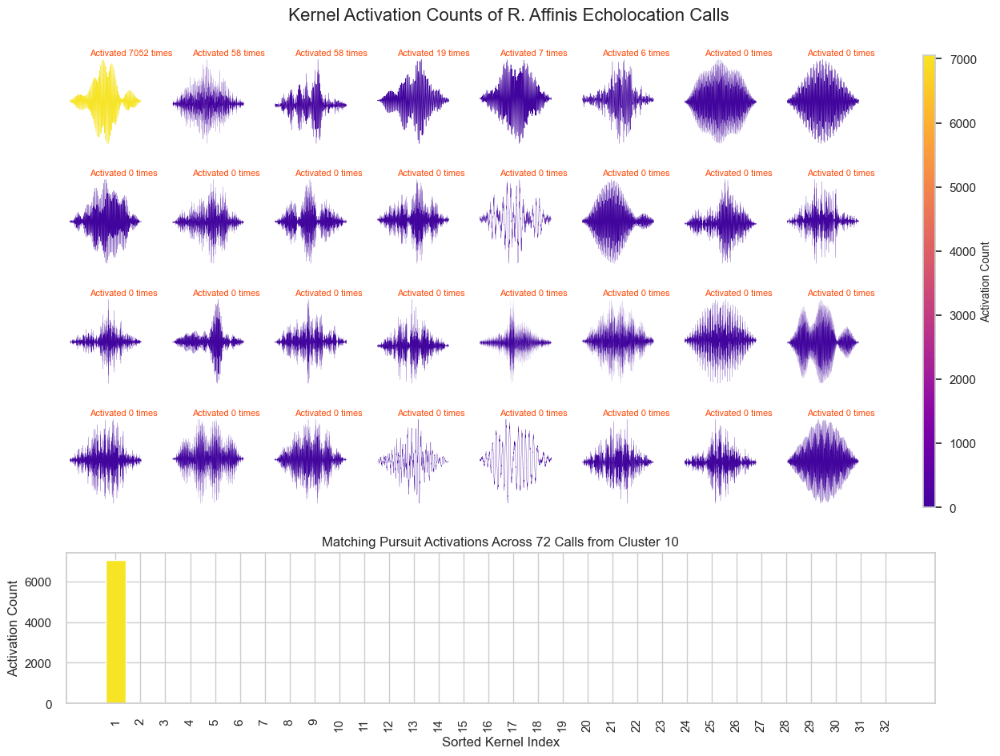

Plotting activations for Cluster 7 (n=72)


C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\3559362173.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


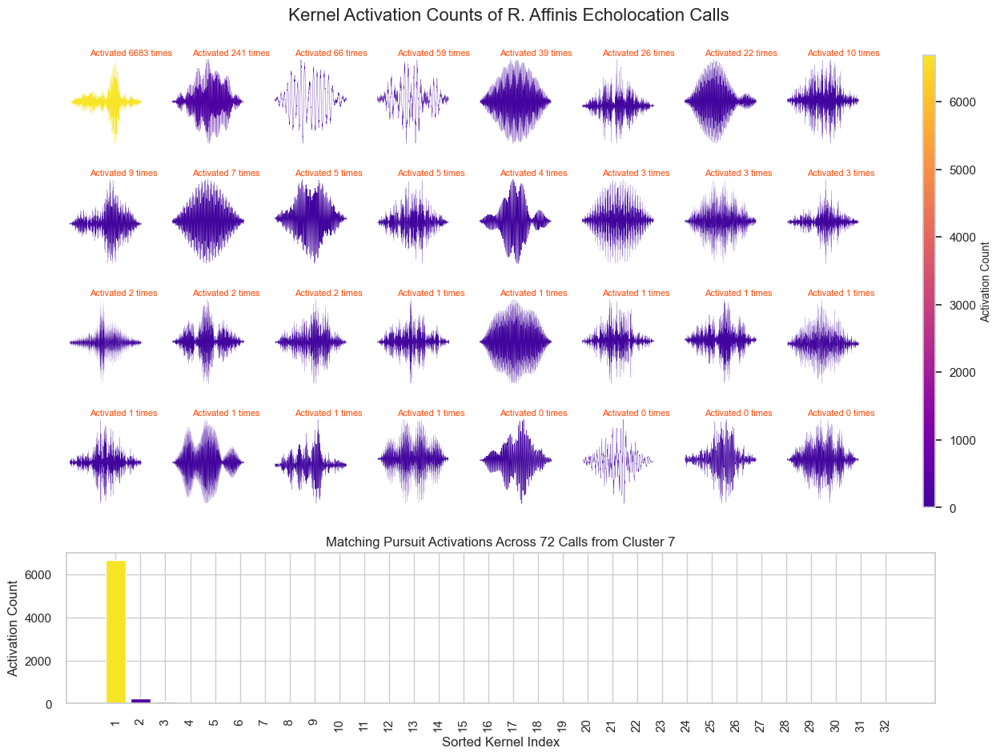

In [367]:
def plot_kernels_per_cluster(csv_path, learned_dictionary, num_files=None, normalize=True):
    df = pd.read_csv(csv_path)

    clusters = df["cluster"].value_counts().sort_values(ascending=False).index.tolist()
    kernel_cols = [col for col in df.columns if col.startswith("kernel_")]

    for cluster_id in clusters:
        # Filter rows for this cluster
        cluster_df = df[df["cluster"] == cluster_id]

        # Sum activations across all files in this cluster
        cluster_activation_counts = cluster_df[kernel_cols].sum().values

        # Plot using your existing function
        print(f"Plotting activations for Cluster {cluster_id} (n={len(cluster_df)})")
        plot_kernels_with_activation(learned_dictionary, cluster_activation_counts, num_files=len(cluster_df), cluster=cluster_id)

# Usage
csv_path = "kernel_activations_per_file_clustered_raw.csv"
learned_dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
plot_kernels_per_cluster(csv_path, learned_dictionary)

In [354]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_proj_local = tsne.fit_transform(X)

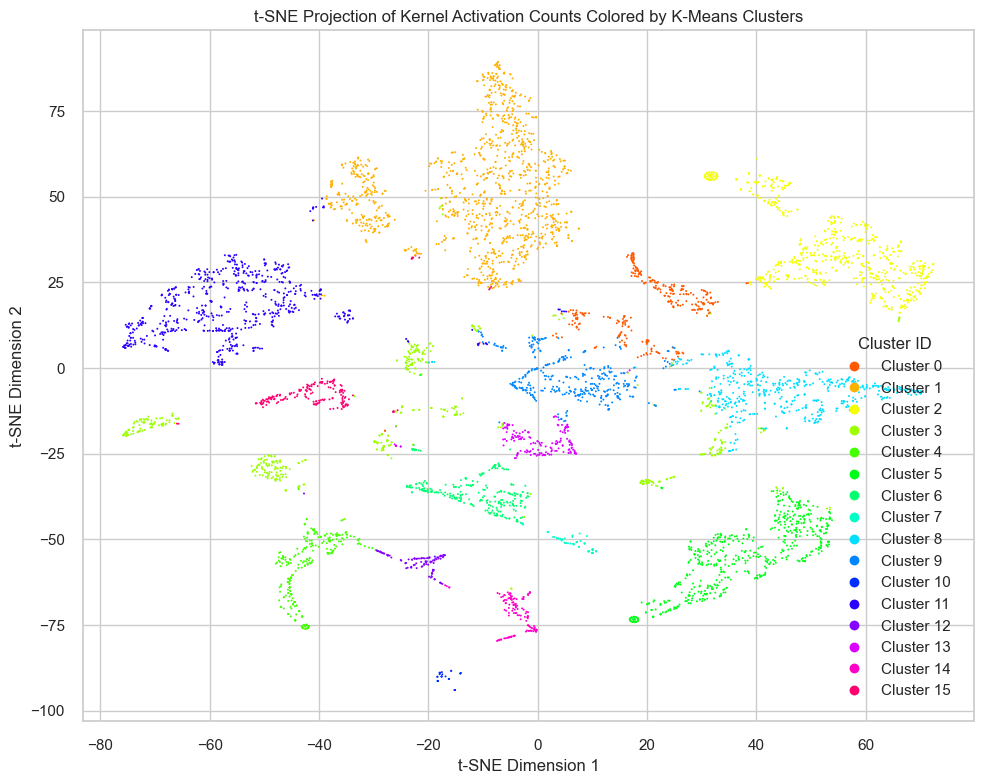

In [355]:

plot_clustered(tsne_proj_local, clusters_raw, type="t-SNE")


In [356]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=90, random_state=42)
tsne_proj_global = tsne.fit_transform(X)

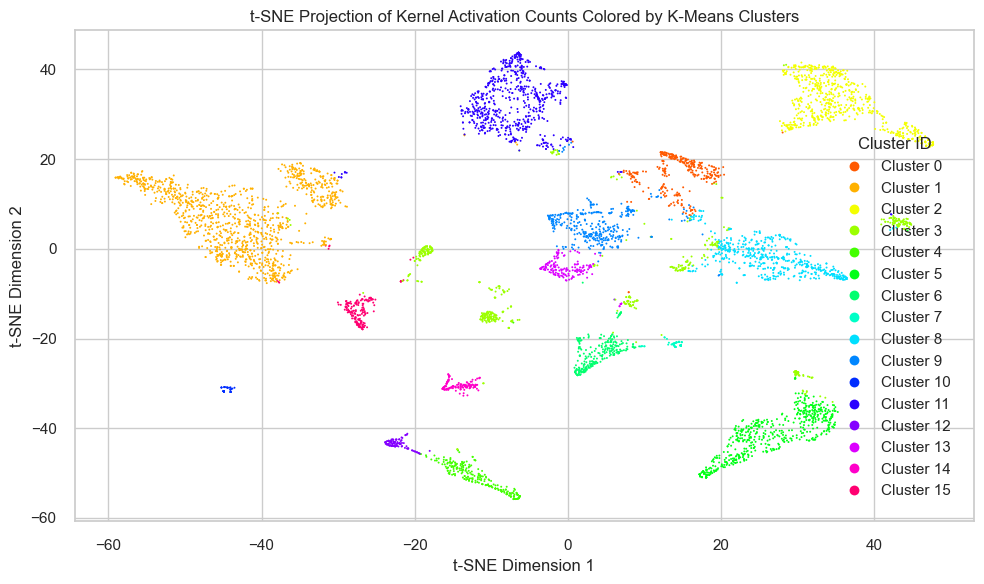

In [360]:
plot_clustered(tsne_proj_global, clusters_raw, type="t-SNE")

In [368]:
from scipy.spatial.distance import cdist

def find_top_central_samples_per_cluster(df_clustered, n_top=5):
    clusters = df_clustered['cluster'].unique()
    central_samples = {}

    activation_cols = [col for col in df_clustered.columns if col not in ['filename', 'cluster']]
    X = df_clustered[activation_cols].values

    for cluster in clusters:
        cluster_mask = df_clustered['cluster'] == cluster
        cluster_data = X[cluster_mask]
        centroid = cluster_data.mean(axis=0, keepdims=True)
        
        dists = cdist(cluster_data, centroid)
        top_idxs = np.argsort(dists.flatten())[:n_top]
        
        filenames = df_clustered.loc[cluster_mask, 'filename'].iloc[top_idxs].tolist()
        central_samples[cluster] = filenames

    return central_samples

In [5]:
def short_filename_id(fname):
    """Extracts the ID in the format 1704-19 from the full filename."""
    match = re.search(r"A00?(\d+)_.*?_call_(\d+)_", fname)
    if match:
        return f"{match.group(1)}-{match.group(2)}"
    else:
        return fname  # fallback if parsing fails

def plot_cluster_spectrograms(waveforms, filenames=None, cluster_number=None, sr=200000, title=None):
    n = len(waveforms)
    fig, axs = plt.subplots(1, n, figsize=(2.5 * n, 3), sharey=True, constrained_layout=True)

    if n == 1:
        axs = [axs]

    max_duration = max(len(y) / sr for y in waveforms) * 1000  # max duration in ms

    for i, y in enumerate(waveforms):
        f, t, Sxx = spectrogram(y, fs=sr, nperseg=1024, noverlap=768)
        t_ms = t * 1000  # convert to milliseconds
        pcm = axs[i].pcolormesh(t_ms, f / 1000, 10 * np.log10(Sxx + 1e-10), shading='gouraud')
        axs[i].set_ylim(0, sr / 2000)
        axs[i].set_xlim(0, max_duration)
        axs[i].set_aspect('auto')
        axs[i].set_xlabel("Time [ms]")
        # axs[i].xaxis.set_major_locator(plt.MaxNLocator(2))

        if filenames is not None:
            short_name = short_filename_id(os.path.basename(filenames[i]))
            axs[i].set_title(f"Rec {i + 1}: {short_name}", fontsize=9)
        else:
            axs[i].set_title(f"Rec {i + 1}", fontsize=10)

        if i == 0:
            axs[i].set_ylabel("Frequency [kHz]")
        else:
            axs[i].set_yticklabels([])

    if title==None:
        default_title = f"Spectrograms"
        if cluster_number is not None:
            default_title += f" for Cluster {cluster_number}"
        fig.suptitle(default_title, fontsize=14)
    else:
        fig.suptitle(title, fontsize=14)
    plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)
    plt.show()

In [11]:
from matplotlib.ticker import MaxNLocator

def plot_two_spectrograms(waveforms, filenames=None, sr=200000, title=None,
                          tick_fontsize=17, label_fontsize=18, 
                          title_fontsize=19, suptitle_fontsize=20, fontname=None):
    assert len(waveforms) == 2, "This function is designed for exactly two waveforms"
    plt.rcParams.update({
        "axes.edgecolor": "#444444",
        "axes.linewidth": 1.1,
        "grid.color": "#cccccc",
        "grid.linewidth": 0.8,
        "legend.frameon": False,
        "mathtext.fontset": "cm",
        "font.family": "DejaVu Sans", 
    })
    
    # Calculate durations and determine plot widths
    duration1 = len(waveforms[0]) / sr * 1000  # duration in ms
    duration2 = len(waveforms[1]) / sr * 1000
    total_duration = duration1 + duration2
    width_ratio = duration1 / total_duration
    
    # Create figure
    fig = plt.figure(figsize=(9, 4))
    gs = fig.add_gridspec(1, 2, width_ratios=[width_ratio, 1 - width_ratio])
    ax1 = fig.add_subplot(gs[0])
    ax2 = fig.add_subplot(gs[1])
    
    # Generate spectrograms
    f1, t1, Sxx1 = spectrogram(waveforms[0], fs=sr, nperseg=1024, noverlap=768)
    f2, t2, Sxx2 = spectrogram(waveforms[1], fs=sr, nperseg=1024, noverlap=768)
    
    # Convert to dB scale and match color limits
    Sxx1_db = 10 * np.log10(Sxx1 + 1e-10)
    Sxx2_db = 10 * np.log10(Sxx2 + 1e-10)
    vmin = min(Sxx1_db.min(), Sxx2_db.min())
    vmax = max(Sxx1_db.max(), Sxx2_db.max())
    
    # Plot spectrograms
    pcm1 = ax1.pcolormesh(t1 * 1000, f1 / 1000, Sxx1_db, shading='gouraud', vmin=vmin, vmax=vmax)
    pcm2 = ax2.pcolormesh(t2 * 1000, f2 / 1000, Sxx2_db, shading='gouraud', vmin=vmin, vmax=vmax)
    
    # Axes settings
    # ax1.set_ylim(0, sr / 2000)
    # ax2.set_ylim(0, sr / 2000)
    # ax1.set_xlim(0, duration1)
    # ax2.set_xlim(0, duration2)
    # For time (x-axis), extend the limit to the max of t * 1000 (ms)
    ax1.set_xlim(t1[0] * 1000, t1[-1] * 1000)
    ax2.set_xlim(t2[0] * 1000, t2[-1] * 1000)

    # For frequency (y-axis), extend the limit to the max frequency (in kHz)
    ax1.set_ylim(f1[0] / 1000, f1[-1] / 1000)
    ax2.set_ylim(f2[0] / 1000, f2[-1] / 1000)

    
    # Labels
    ax1.set_xlabel("Time (ms)", fontsize=label_fontsize, fontname=fontname)
    ax1.set_ylabel("Frequency (kHz)", fontsize=label_fontsize, fontname=fontname)
    ax2.set_xlabel("Time (ms)", fontsize=label_fontsize, fontname=fontname)
    ax2.set_yticklabels([])

    # Tick font sizes
    ax1.tick_params(labelsize=tick_fontsize)
    ax2.tick_params(labelsize=tick_fontsize)
    # Set 4 evenly spaced, rounded xticks for each subplot
    ax1.xaxis.set_major_locator(MaxNLocator(nbins=7, prune=None))
    ax2.xaxis.set_major_locator(MaxNLocator(nbins=7, prune=None))

    
    # Titles
    if filenames is not None:
        name1 = short_filename_id(os.path.basename(filenames[0]))
        name2 = short_filename_id(os.path.basename(filenames[1]))
        ax1.set_title(f"(a) R. affinis: {name1}", fontsize=title_fontsize, fontname=fontname)
        ax2.set_title(f"(b) R. pearsonii: {name2}", fontsize=title_fontsize, fontname=fontname)
    else:
        ax1.set_title("(a) Rec 1", fontsize=title_fontsize, fontname=fontname)
        ax2.set_title("(b) Rec 2", fontsize=title_fontsize, fontname=fontname)
    
    # Colorbar
    cbar = fig.colorbar(pcm2, ax=ax2, location='right', pad=0.04)
    cbar.set_label('Power Spectral Density (dB)    ', rotation=90, labelpad=5,
                   fontsize=label_fontsize, fontname=fontname)
    cbar.ax.tick_params(labelsize=tick_fontsize)

    # Suptitle
    # if title:
        # fig.suptitle(title, fontsize=suptitle_fontsize, fontname=fontname)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.85)
    plt.show()
    return fig

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


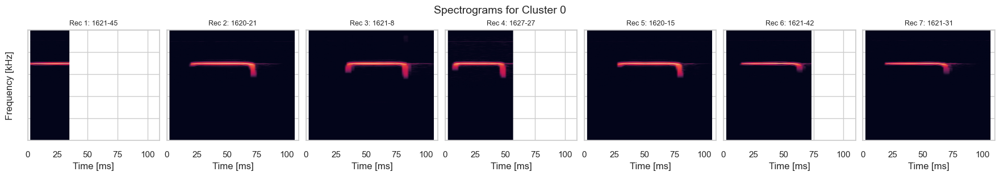

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


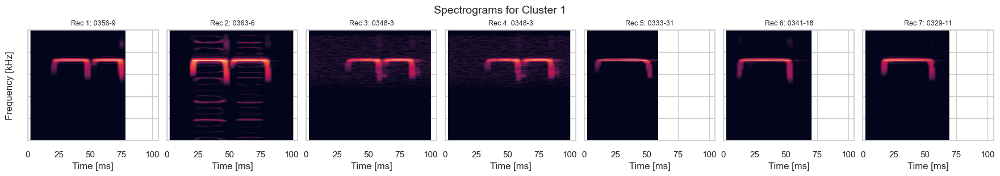

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


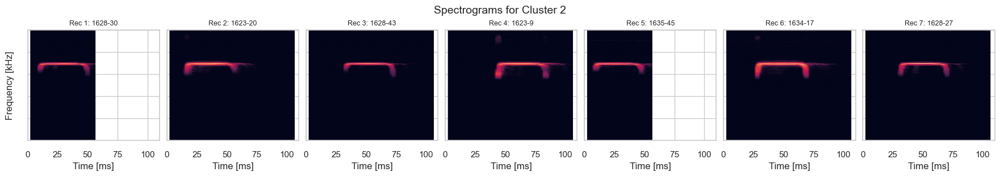

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


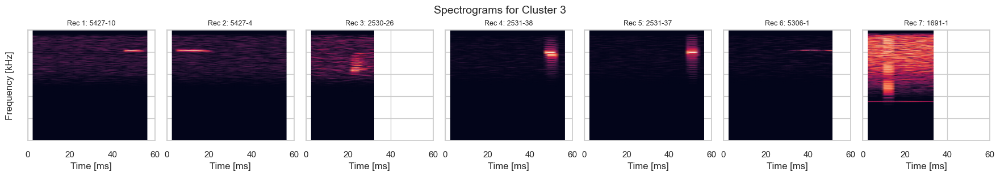

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


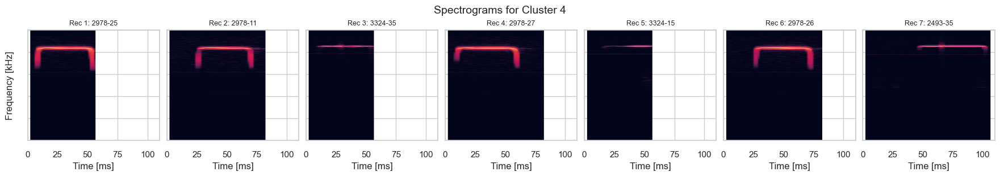

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


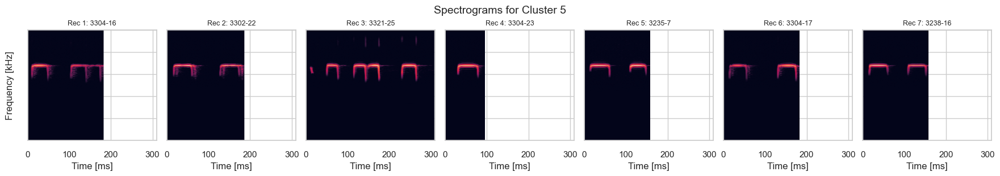

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


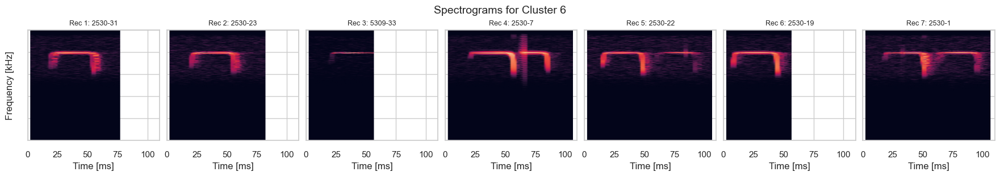

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


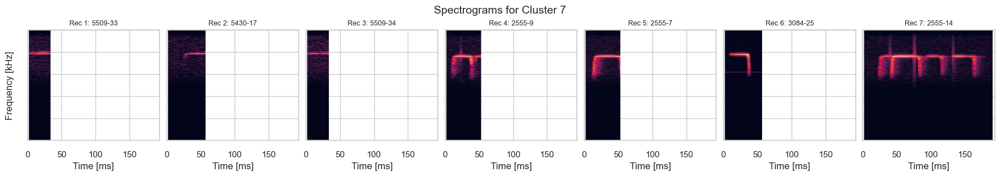

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


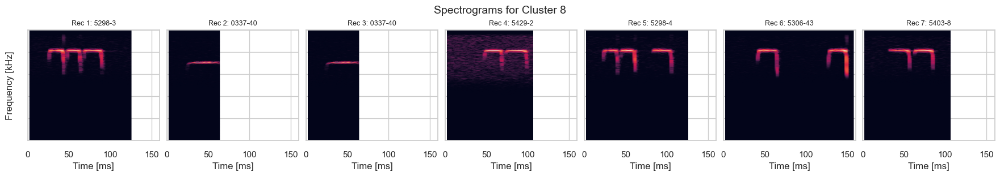

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


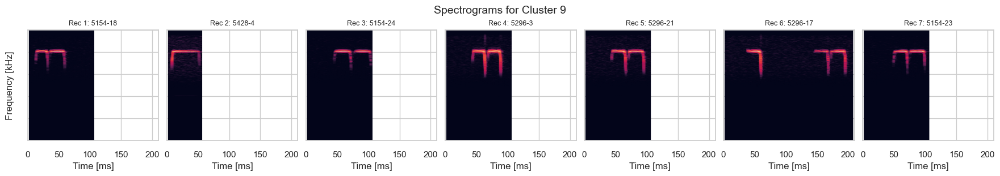

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


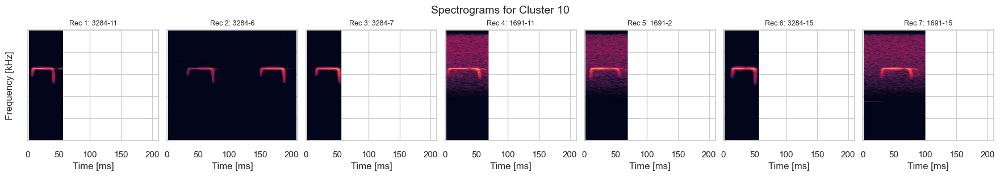

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


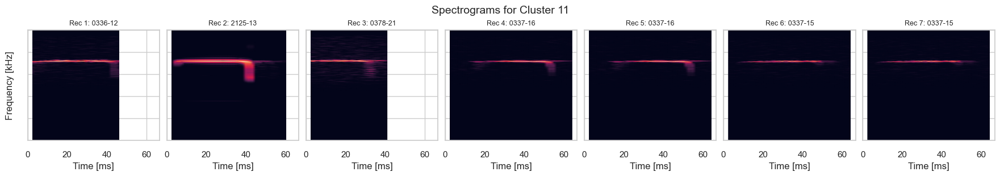

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


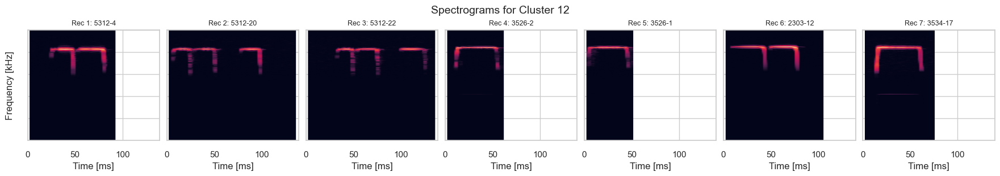

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


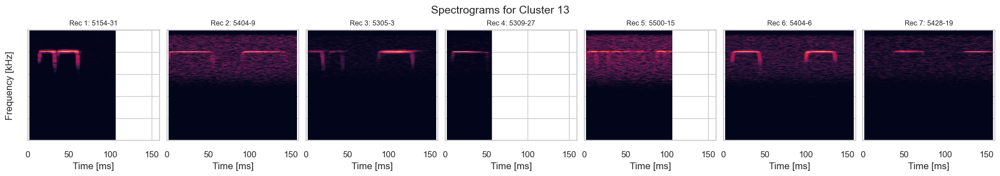

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


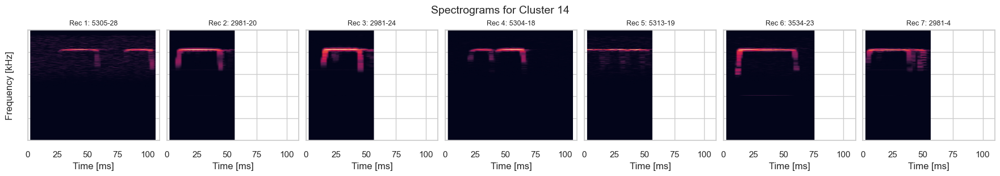

C:\Users\alexa\AppData\Local\Temp\ipykernel_41112\2448944941.py:45: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.06, right=0.98, top=0.85, bottom=0.12, wspace=0)


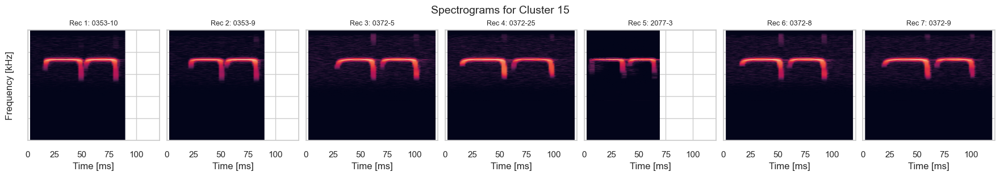

In [415]:
central_samples = find_top_central_samples_per_cluster(df_clustered_raw, n_top=7)

for cluster in sorted(central_samples.keys()):
    filenames = central_samples[cluster]
    waveforms = []
    for filename in filenames:
        waveform, sr = sf.read("high_rhinolophus_affinis_segments/" + filename)
        waveforms.append(waveform)

    plot_cluster_spectrograms(waveforms, filenames=filenames, cluster_number=cluster, sr=sr)

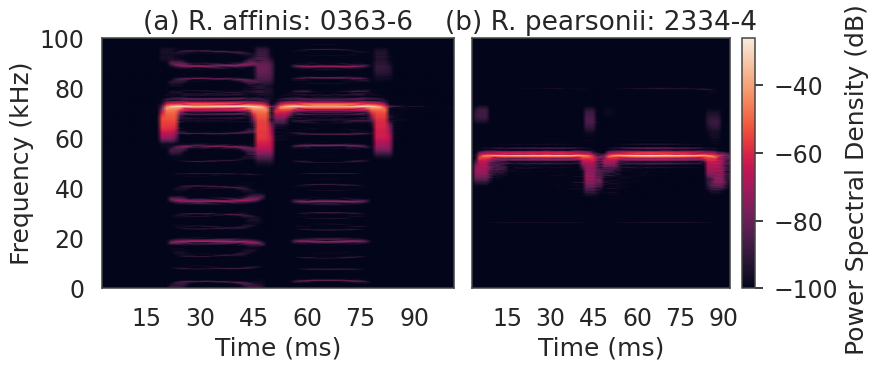

In [12]:
filename1 = "A000363_ARROXDRQGG_call_6_1.20-1.30s.wav"
waveform1, sr = sf.read("high_rhinolophus_affinis_segments/" + filename1)
filename2 = "A002334_BWEKNFNHIQ_call_4_0.28-0.37s.wav"
waveform2, sr2 = sf.read("high_rhinolophus_pearsonii_segments/" + filename2)
waveforms = [waveform1, waveform2]
filenames = [filename1, filename2]
fig = plot_two_spectrograms(waveforms, filenames=filenames, sr=sr, title="Spectrograms of Rhinolophidae CF-FM Echolocation Calls")

In [13]:
fig.savefig("diagrams/bat_calls.pdf", bbox_inches='tight')


In [104]:
# --- Configurations ---
cluster_csv = "kernel_activations_per_file_clustered_raw.csv"
audio_folder = "high_rhinolophus_affinis_segments"
dictionary_path = "kernels_high_400_10000.jld2"
output_csv = "detailed_kernel_activations_cluster_{cluster_id}.csv"

cluster_id = 13

# --- Load the dictionary ---
learned_dictionary = mp.create_dictionary_from_JLD2(dictionary_path)
num_kernels = len(learned_dictionary)

# --- Load CSV with cluster info ---
df = pd.read_csv(cluster_csv)
cluster_filenames = df[df['cluster'] == cluster_id]['filename'].tolist()

# --- Matching Pursuit configuration ---
stop_type = "iterations"
stop_condition = 100  # fixed number of atoms

# --- Store results ---
activation_rows = []

print(f"Processing {len(cluster_filenames)} files from cluster {cluster_id}...")

for file in tqdm(cluster_filenames):
    filepath = os.path.join(audio_folder, file)
    waveform, sr = sf.read(filepath)

    # Normalize waveform
    waveform = waveform.astype(np.float64)
    waveform /= np.max(np.abs(waveform))

    # Run Matching Pursuit
    encoded, _ = mp.matching_pursuit(learned_dictionary, waveform, stop_type, stop_condition)

    for i, (kernel_index, coefficient, time_shift) in enumerate(encoded):
        activation_rows.append([file, i, kernel_index, coefficient, time_shift])

# --- Save to CSV ---
with open(output_csv.format(cluster_id=cluster_id), 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(["filename", "iteration", "kernel_index", "coefficient", "time_shift"])
    writer.writerows(activation_rows)

print(f"Saved detailed activations to {output_csv.format(cluster_id=cluster_id)}")


Processing 161 files from cluster 13...


100%|██████████| 161/161 [20:23<00:00,  7.60s/it] 

Saved detailed activations to detailed_kernel_activations_cluster_13.csv


In [93]:
def plot_cluster_reconstruction_spectrogram(
    activations_csv,
    dictionary_path,
    cluster_id=10,
    sr=200000,
    waveform_length=700000,
    n_fft=1024,
    hop_length=256
):
    # --- Load dictionary ---
    dictionary = mp.create_dictionary_from_JLD2(dictionary_path)

    # --- Load activations ---
    df = pd.read_csv(activations_csv)

    # --- Get unique iterations ---
    iterations = df['iteration'].unique()
    num_iterations = len(iterations)

    # --- Accumulate reconstructed signals ---
    accumulated = np.zeros(waveform_length)

    for iteration in iterations:
        reconstructed = np.zeros(waveform_length)
        df_iter = df[df['iteration'] == iteration]

        for _, row in df_iter.iterrows():
            kernel = dictionary[int(row['kernel_index'])].kernel
            coeff = row['coefficient']
            shift = int(row['time_shift'])

            if shift + len(kernel) <= len(reconstructed):
                reconstructed[shift:shift + len(kernel)] += coeff * kernel

        accumulated += reconstructed

    # --- Normalize by number of iterations ---
    averaged_reconstruction = accumulated / num_iterations

    # --- Compute spectrogram ---
    S = np.abs(librosa.stft(averaged_reconstruction, n_fft=n_fft, hop_length=hop_length))
    avg_spec = librosa.amplitude_to_db(S, ref=np.max)

    # --- Plot using librosa display ---
    plt.figure(figsize=(10, 6))
    librosa.display.specshow(avg_spec, sr=sr, hop_length=hop_length,
                             y_axis='linear', x_axis='time', cmap='magma')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"Average Reconstruction Spectrogram for Cluster {cluster_id}")
    plt.tight_layout()
    plt.show()



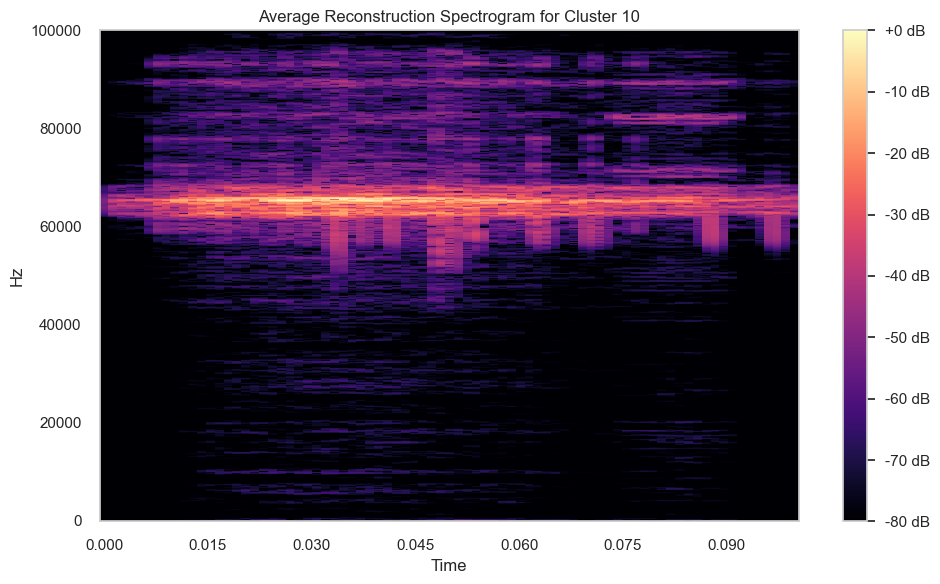

In [178]:
plot_cluster_reconstruction_spectrogram(
    activations_csv="detailed_kernel_activations_cluster_10.csv",
    dictionary_path="kernels_high_400_10000.jld2",
    cluster_id=10,
	waveform_length=20000
)

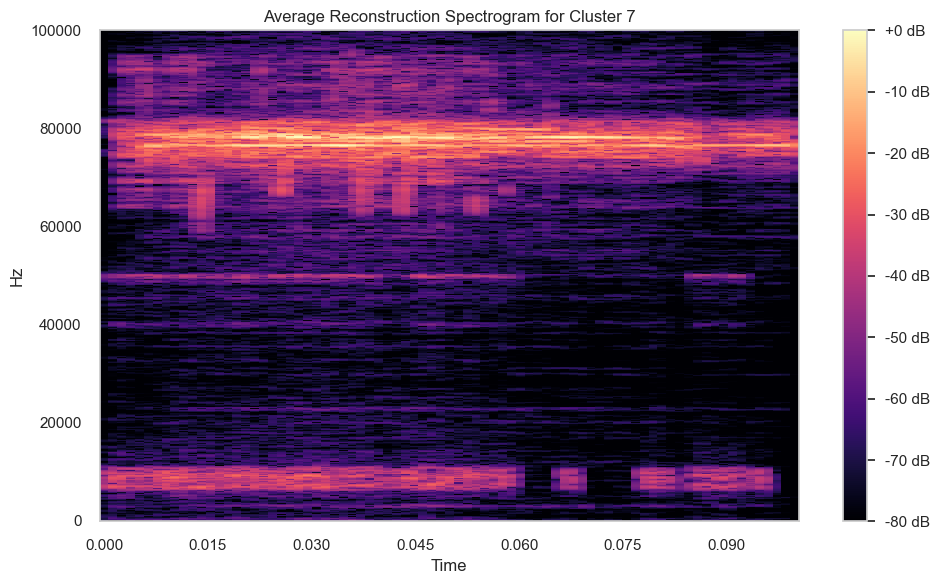

In [177]:
plot_cluster_reconstruction_spectrogram(
    activations_csv="detailed_kernel_activations_cluster_7.csv",
    dictionary_path="kernels_high_400_10000.jld2",
    cluster_id=7,
	waveform_length=20000
)


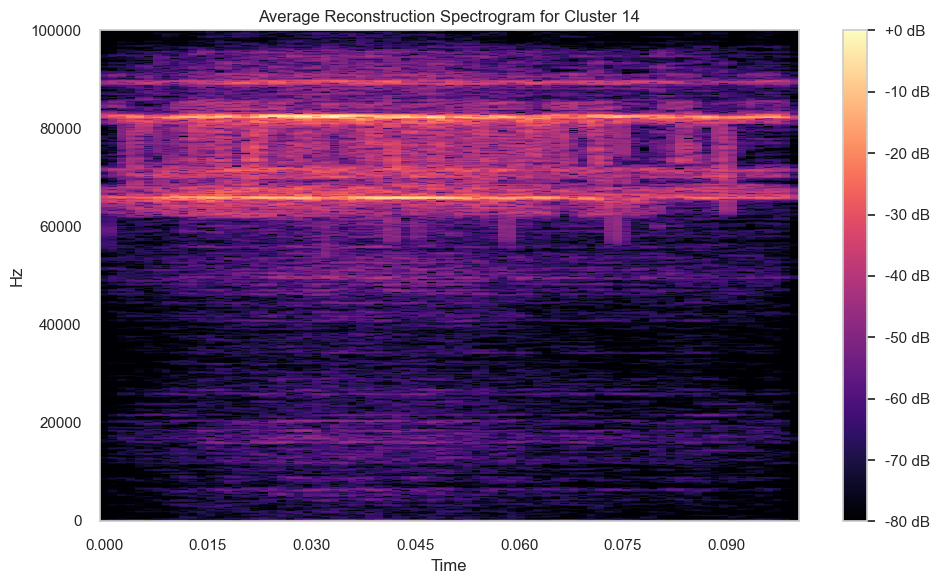

In [176]:
plot_cluster_reconstruction_spectrogram(
    activations_csv="detailed_kernel_activations_cluster_14.csv",
    dictionary_path="kernels_high_400_10000.jld2",
    cluster_id=14,
	waveform_length=20000
)


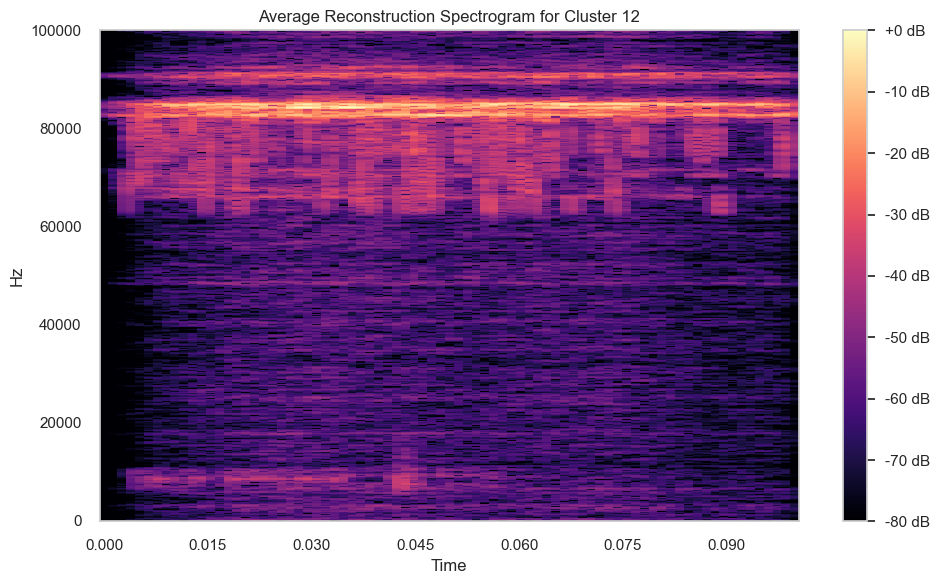

In [175]:
plot_cluster_reconstruction_spectrogram(
    activations_csv="detailed_kernel_activations_cluster_12.csv",
    dictionary_path="kernels_high_400_10000.jld2",
    cluster_id=12,
	waveform_length=20000
)


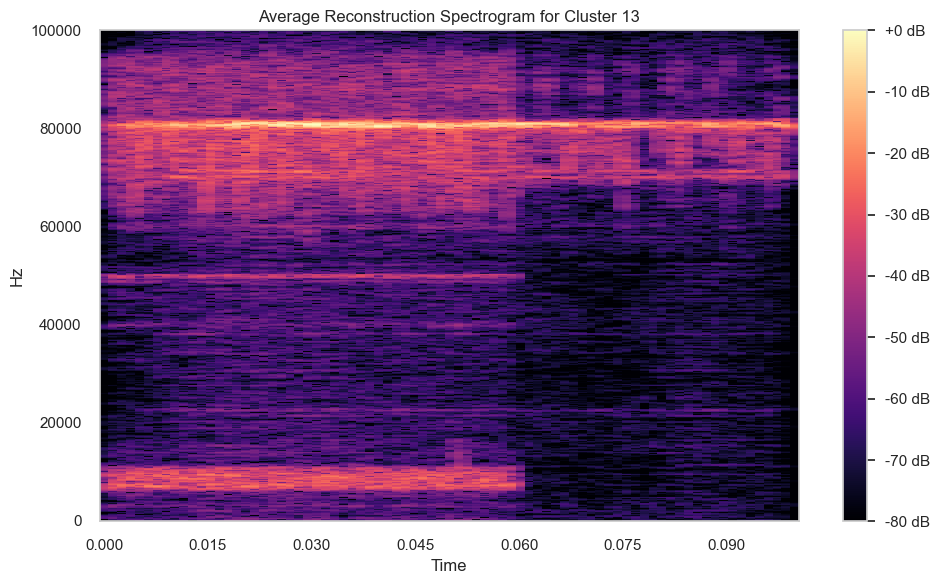

In [173]:
plot_cluster_reconstruction_spectrogram(
    activations_csv="detailed_kernel_activations_cluster_13.csv",
    dictionary_path="kernels_high_400_10000.jld2",
    cluster_id=13,
	waveform_length=20000
)


In [283]:
sr = 200000  # Sample rate in Hz

# --- Load dictionary ---
learned_dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")

from scipy.signal import hilbert
from scipy.stats import skew, kurtosis

def modulation_rate(kernel, sr):
    envelope = np.abs(hilbert(kernel))
    envelope_diff = np.diff(envelope)
    rate = np.mean(np.abs(envelope_diff)) * sr
    return rate

# --- Feature extraction ---
def extract_features(kernel, sr):
    duration_ms = len(kernel) / sr * 1000.0

    # Spectrogram
    f, t, Sxx = spectrogram(kernel, fs=sr, nperseg=64, noverlap=32)
    Sxx_mean = np.mean(Sxx, axis=1)
    Sxx_norm = Sxx_mean / (np.sum(Sxx_mean) + 1e-10)

    centroid = np.sum(f * Sxx_norm)
    bandwidth = np.sqrt(np.sum(((f - centroid) ** 2) * Sxx_norm))
    peak_freq = f[np.argmax(Sxx_mean)]
    entropy = -np.sum(Sxx_norm * np.log2(Sxx_norm + 1e-10))

    # Temporal features
    zcr = np.mean(np.abs(np.diff(np.sign(kernel))))
    mod_rate = modulation_rate(kernel, sr)
    skew_val = skew(kernel)
    kurt_val = kurtosis(kernel)

    return [
        centroid, bandwidth, peak_freq, entropy, zcr, mod_rate, skew_val, kurt_val, duration_ms
    ]


features = np.array([extract_features(k.kernel, sr) for k in learned_dictionary])

# --- Scale features ---
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

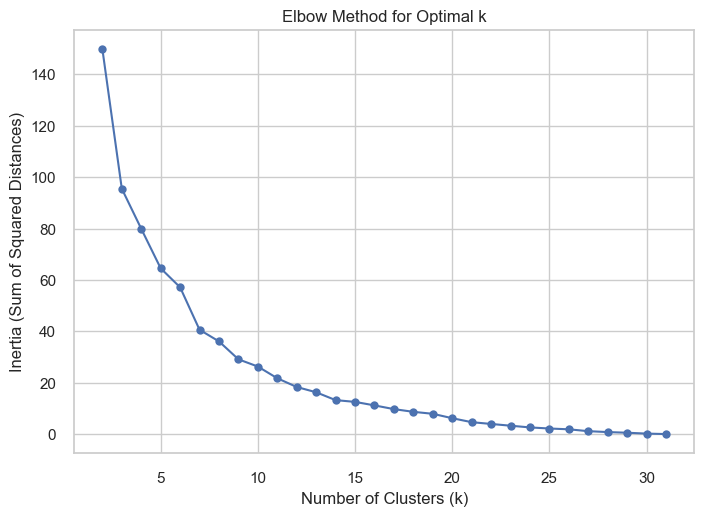

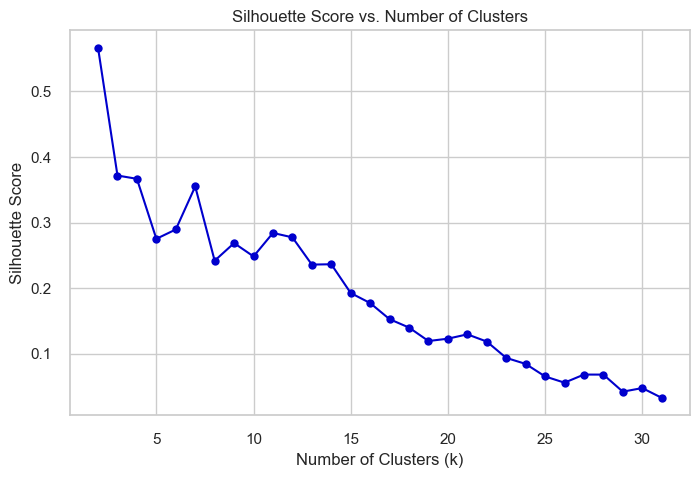

[np.float64(0.5665956075270417),
 np.float64(0.3717631236548238),
 np.float64(0.36673731092628964),
 np.float64(0.2752083640262384),
 np.float64(0.28945961464244785),
 np.float64(0.3551052170297767),
 np.float64(0.2418202984771346),
 np.float64(0.26866780925645023),
 np.float64(0.24835849401833468),
 np.float64(0.2841586628655769),
 np.float64(0.27743309097291424),
 np.float64(0.2358912024598805),
 np.float64(0.23640904896365958),
 np.float64(0.19253708146566323),
 np.float64(0.17720573825874042),
 np.float64(0.15261399482614527),
 np.float64(0.1398443959798915),
 np.float64(0.11929724106065862),
 np.float64(0.12285678148650778),
 np.float64(0.12949724762537268),
 np.float64(0.1184857049065737),
 np.float64(0.09358198667001061),
 np.float64(0.08439494697271807),
 np.float64(0.06528402591194624),
 np.float64(0.05575351167133405),
 np.float64(0.06812605177634487),
 np.float64(0.06807305846679879),
 np.float64(0.042019132276042905),
 np.float64(0.047544559769253494),
 np.float64(0.0326643

In [146]:
evaluate_elbow_method(features_scaled, range(2, 32))
evaluate_silhouette_scores(features_scaled, range(2, 32))

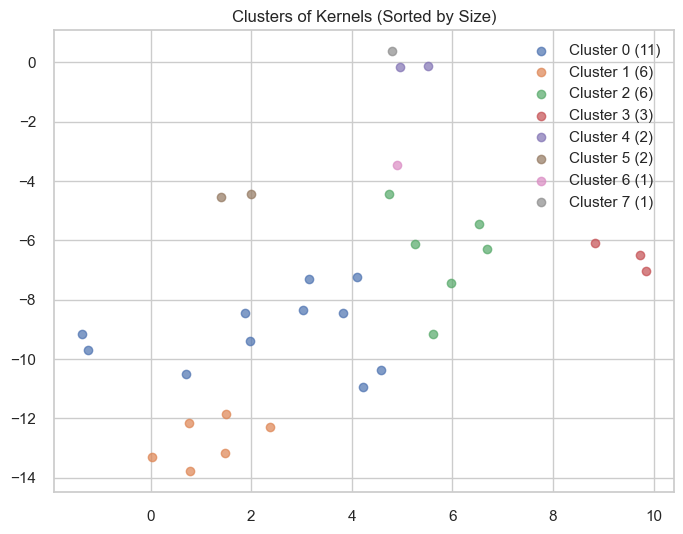

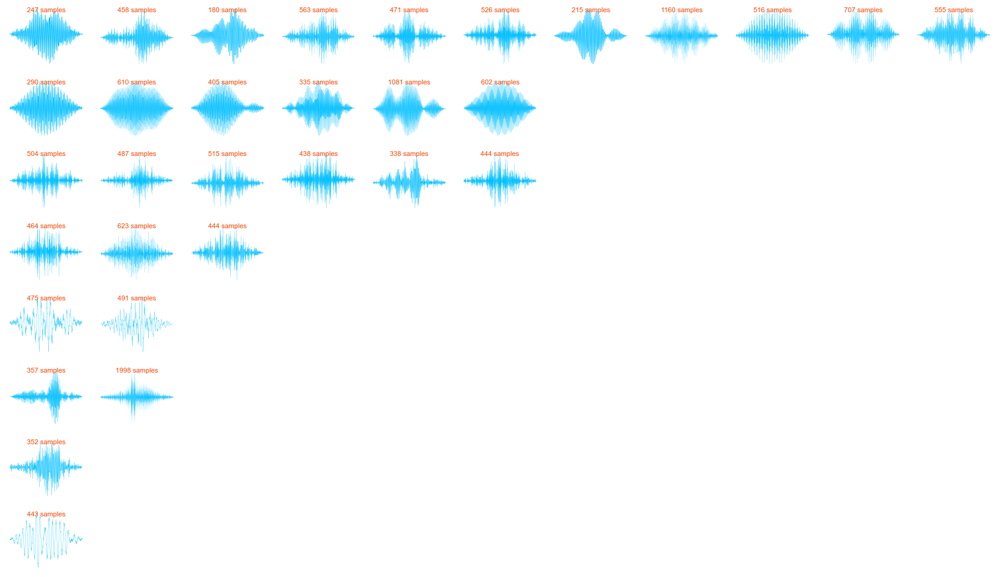

In [ ]:
from collections import Counter

# --- Clustering ---
n_clusters = 7
kmeans = KMeans(n_clusters=n_clusters, random_state=0)
labels = kmeans.fit_predict(features_scaled)

# --- Compute cluster sizes and sort them descending ---
cluster_sizes = Counter(labels)
sorted_clusters = [cluster for cluster, _ in cluster_sizes.most_common()]

# --- Create a mapping from old cluster ID to new sorted order ---
cluster_order = {old: new for new, old in enumerate(sorted_clusters)}
sorted_labels = np.array([cluster_order[l] for l in labels])

# --- t-SNE visualization ---
tsne = TSNE(n_components=2, perplexity=10, random_state=42)
embedding = tsne.fit_transform(features_scaled)

plt.figure(figsize=(8, 6))
for cluster_id in range(n_clusters):
    idxs = np.where(sorted_labels == cluster_id)[0]
    plt.scatter(*embedding[idxs].T, label=f"Cluster {cluster_id} ({len(idxs)})", alpha=0.7)
plt.legend()
plt.title("Clusters of Kernels (Sorted by Size)")
plt.show()
# Get max cluster size for dynamic column count
max_examples = max([np.sum(labels == cid) for cid in sorted_clusters])

# Create subplots with dynamic number of columns
fig, axs = plt.subplots(n_clusters, max_examples, figsize=(max_examples * 1.5, n_clusters * 1.2))

# Ensure axs is always 2D
if n_clusters == 1:
    axs = np.expand_dims(axs, axis=0)
if max_examples == 1:
    axs = np.expand_dims(axs, axis=1)

for new_cluster_id in range(n_clusters):
    old_cluster_id = sorted_clusters[new_cluster_id]
    idxs = np.where(labels == old_cluster_id)[0]

    for j in range(max_examples):
        ax = axs[new_cluster_id, j]
        ax.axis("off")

        if j < len(idxs):
            idx = idxs[j]
            kernel = learned_dictionary[idx].kernel
            kernel_length = len(kernel)

            ax.plot(kernel, linewidth=100.0 / kernel_length, color='deepskyblue')
            ax.text(0.5, 0.9, f"{kernel_length} samples", fontsize=8,
                    color='orangered', transform=ax.transAxes, ha='center')

    axs[new_cluster_id, 0].set_ylabel(
        f"Cluster {new_cluster_id}\n(n={len(idxs)})",
        rotation=0, labelpad=30, va='center'
    )

plt.tight_layout()
plt.show()


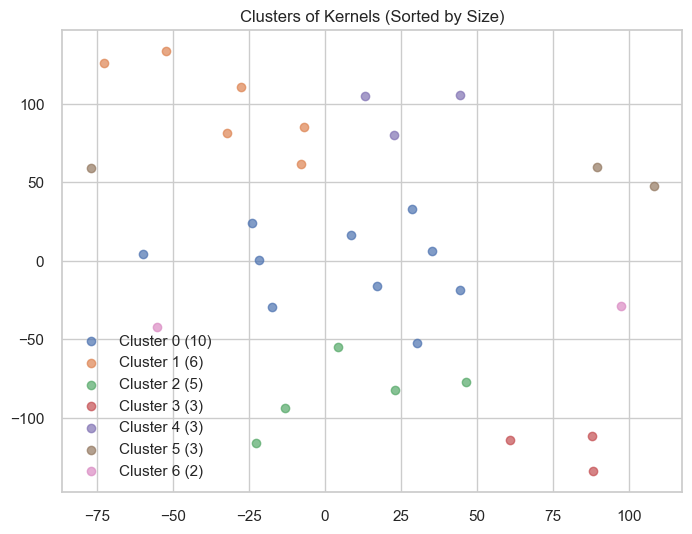

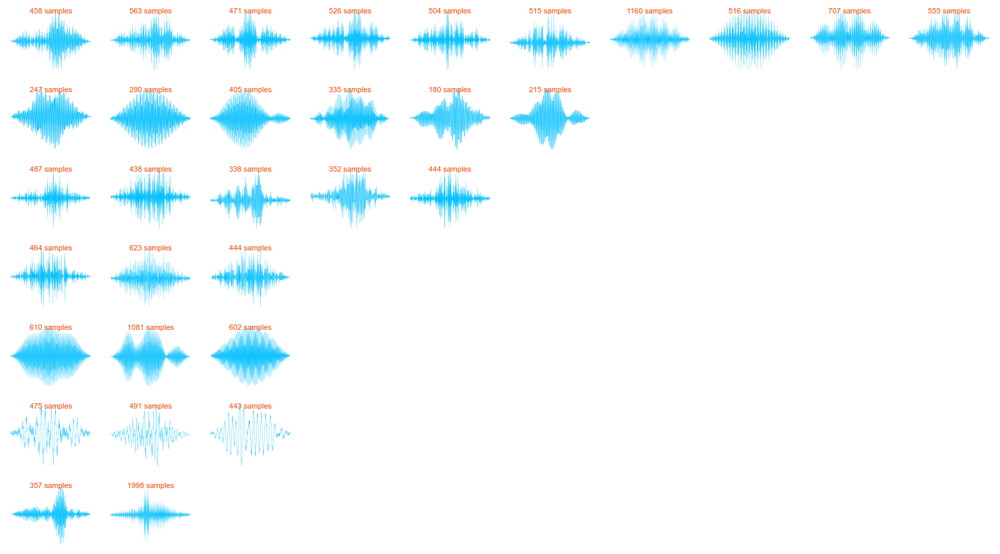

In [163]:
from sklearn.cluster import SpectralClustering

# --- Clustering with Spectral Clustering ---
n_clusters = 7
spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=0)
labels = spectral.fit_predict(features_scaled)

# --- Sort clusters by size ---
from collections import Counter
cluster_sizes = Counter(labels)
sorted_clusters = [cluster for cluster, _ in cluster_sizes.most_common()]
cluster_order = {old: new for new, old in enumerate(sorted_clusters)}
sorted_labels = np.array([cluster_order[l] for l in labels])

# --- t-SNE visualization ---
tsne = TSNE(n_components=2, perplexity=10, random_state=42)
embedding = tsne.fit_transform(features_scaled)

plt.figure(figsize=(8, 6))
for cluster_id in range(n_clusters):
    idxs = np.where(sorted_labels == cluster_id)[0]
    plt.scatter(*embedding[idxs].T, label=f"Cluster {cluster_id} ({len(idxs)})", alpha=0.7)
plt.legend()
plt.title("Clusters of Kernels (Sorted by Size)")
plt.show()
# Get max cluster size for dynamic column count
max_examples = max([np.sum(labels == cid) for cid in sorted_clusters])

# Create subplots with dynamic number of columns
fig, axs = plt.subplots(n_clusters, max_examples, figsize=(max_examples * 1.5, n_clusters * 1.2))

# Ensure axs is always 2D
if n_clusters == 1:
    axs = np.expand_dims(axs, axis=0)
if max_examples == 1:
    axs = np.expand_dims(axs, axis=1)

for new_cluster_id in range(n_clusters):
    old_cluster_id = sorted_clusters[new_cluster_id]
    idxs = np.where(labels == old_cluster_id)[0]

    for j in range(max_examples):
        ax = axs[new_cluster_id, j]
        ax.axis("off")

        if j < len(idxs):
            idx = idxs[j]
            kernel = learned_dictionary[idx].kernel
            kernel_length = len(kernel)

            ax.plot(kernel, linewidth=100.0 / kernel_length, color='deepskyblue')
            ax.text(0.5, 0.9, f"{kernel_length} samples", fontsize=8,
                    color='orangered', transform=ax.transAxes, ha='center')

    axs[new_cluster_id, 0].set_ylabel(
        f"Cluster {new_cluster_id}\n(n={len(idxs)})",
        rotation=0, labelpad=30, va='center'
    )

plt.tight_layout()
plt.show()


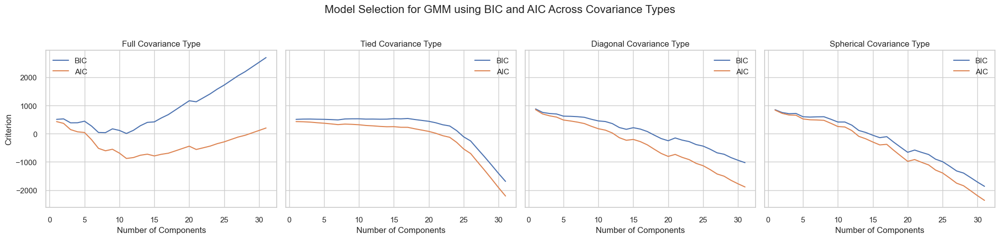

In [204]:
from sklearn.mixture import GaussianMixture

n_components_range = range(1, 32)
covariance_types = ['full', 'tied', 'diag', 'spherical']
title_map = {
    'full': 'Full Covariance Type',
    'tied': 'Tied Covariance Type',
    'diag': 'Diagonal Covariance Type',
    'spherical': 'Spherical Covariance Type'
}

fig, axs = plt.subplots(1, 4, figsize=(20, 5), sharey=True)

for i, cov_type in enumerate(covariance_types):
    bics = []
    aics = []

    for n in n_components_range:
        gmm = GaussianMixture(n_components=n, covariance_type=cov_type, random_state=0)
        gmm.fit(features_scaled)
        bics.append(gmm.bic(features_scaled))
        aics.append(gmm.aic(features_scaled))

    axs[i].plot(n_components_range, bics, label='BIC')
    axs[i].plot(n_components_range, aics, label='AIC')
    axs[i].set_title(title_map[cov_type])
    axs[i].set_xlabel('Number of Components')
    if i == 0:
        axs[i].set_ylabel('Criterion')
    axs[i].legend()

fig.suptitle('Model Selection for GMM using BIC and AIC Across Covariance Types', fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

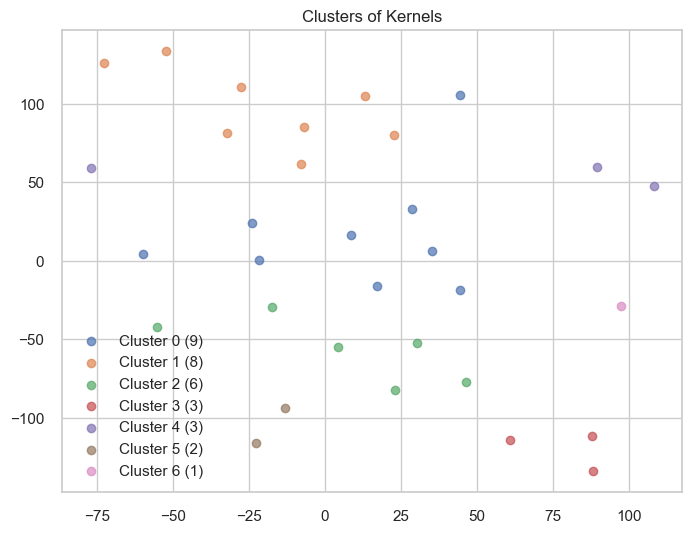

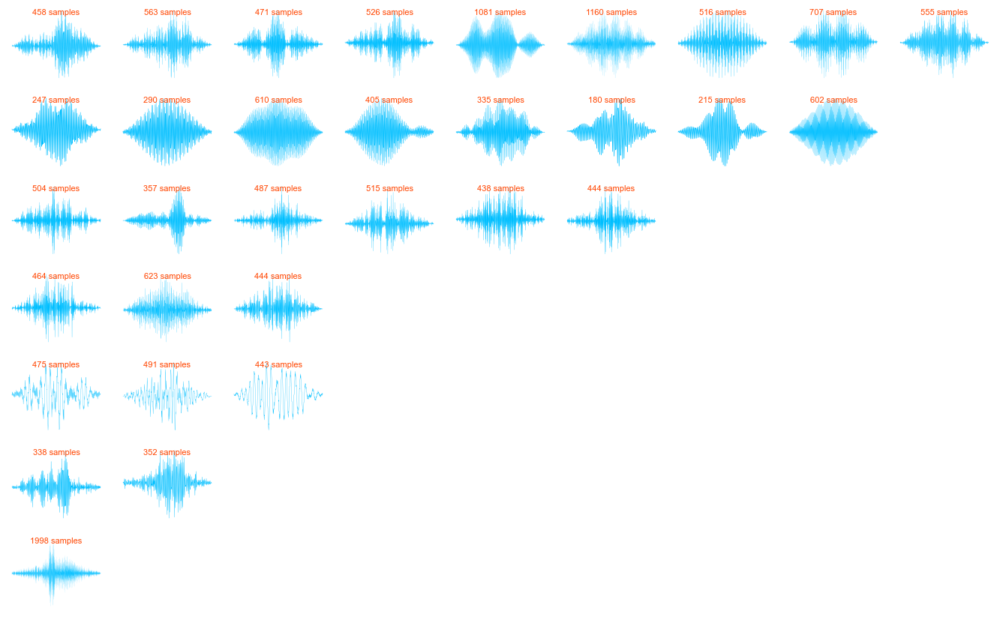

In [205]:
from sklearn.mixture import GaussianMixture
from collections import Counter

# --- GMM Clustering ---
n_clusters = 7
gmm = GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=0)
labels = gmm.fit_predict(features_scaled)

# --- Sort clusters by size ---
cluster_sizes = Counter(labels)
sorted_clusters = [cluster for cluster, _ in cluster_sizes.most_common()]
cluster_order = {old: new for new, old in enumerate(sorted_clusters)}
sorted_labels = np.array([cluster_order[l] for l in labels])

# --- t-SNE visualization ---
tsne = TSNE(n_components=2, perplexity=10, random_state=42)
embedding = tsne.fit_transform(features_scaled)

plt.figure(figsize=(8, 6))
for cluster_id in range(n_clusters):
    idxs = np.where(sorted_labels == cluster_id)[0]
    plt.scatter(*embedding[idxs].T, label=f"Cluster {cluster_id} ({len(idxs)})", alpha=0.7)
plt.legend()
plt.title("Clusters of Kernels")
plt.show()

# --- Plot kernels per cluster ---
max_examples = max([np.sum(labels == cid) for cid in sorted_clusters])

fig, axs = plt.subplots(n_clusters, max_examples, figsize=(max_examples * 1.5, n_clusters * 1.2))

# Ensure axs is always 2D
if n_clusters == 1:
    axs = np.expand_dims(axs, axis=0)
if max_examples == 1:
    axs = np.expand_dims(axs, axis=1)

for new_cluster_id in range(n_clusters):
    old_cluster_id = sorted_clusters[new_cluster_id]
    idxs = np.where(labels == old_cluster_id)[0]

    for j in range(max_examples):
        ax = axs[new_cluster_id, j]
        ax.axis("off")

        if j < len(idxs):
            idx = idxs[j]
            kernel = learned_dictionary[idx].kernel
            kernel_length = len(kernel)

            ax.plot(kernel, linewidth=100.0 / kernel_length, color='deepskyblue')
            ax.text(0.5, 0.9, f"{kernel_length} samples", fontsize=8,
                    color='orangered', transform=ax.transAxes, ha='center')

    axs[new_cluster_id, 0].set_ylabel(
        f"Cluster {new_cluster_id}\n(n={len(idxs)})",
        rotation=0, labelpad=30, va='center'
    )

plt.tight_layout()
plt.show()


C:\Users\alexa\AppData\Local\Temp\ipykernel_19804\1482079657.py:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap('tab10')  # Up to 10 distinct colors; change if n_clusters > 10


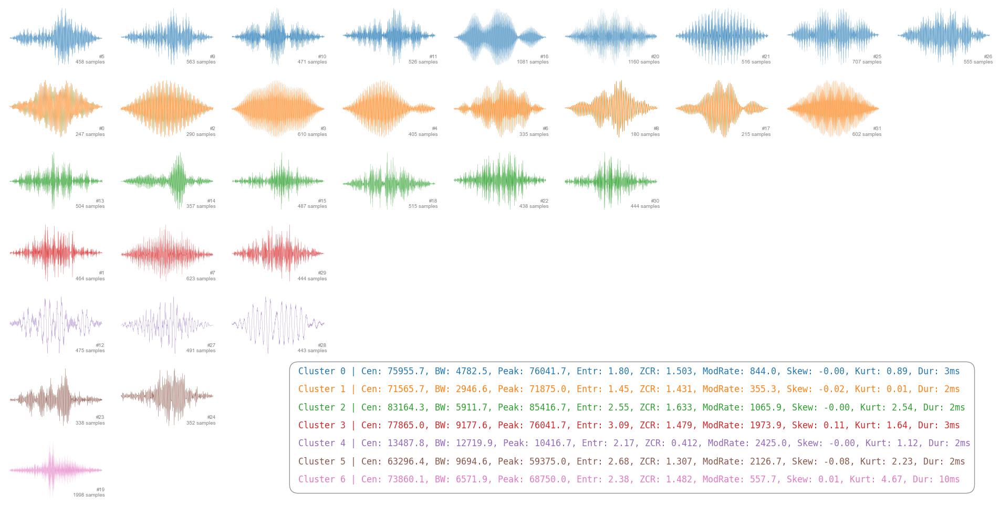

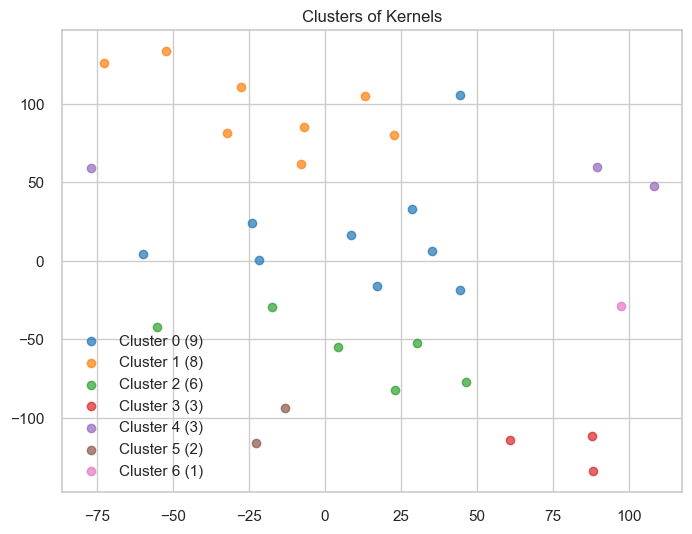

Cluster 0 | Cen: 75955.7, BW: 4782.5, Peak: 76041.7, Entr: 1.80, ZCR: 1.503, ModRate: 844.0, Skew: -0.00, Kurt: 0.89, Dur: 3ms
Cluster 1 | Cen: 71565.7, BW: 2946.6, Peak: 71875.0, Entr: 1.45, ZCR: 1.431, ModRate: 355.3, Skew: -0.02, Kurt: 0.01, Dur: 2ms
Cluster 2 | Cen: 83164.3, BW: 5911.7, Peak: 85416.7, Entr: 2.55, ZCR: 1.633, ModRate: 1065.9, Skew: -0.00, Kurt: 2.54, Dur: 2ms
Cluster 3 | Cen: 77865.0, BW: 9177.6, Peak: 76041.7, Entr: 3.09, ZCR: 1.479, ModRate: 1973.9, Skew: 0.11, Kurt: 1.64, Dur: 3ms
Cluster 4 | Cen: 13487.8, BW: 12719.9, Peak: 10416.7, Entr: 2.17, ZCR: 0.412, ModRate: 2425.0, Skew: -0.00, Kurt: 1.12, Dur: 2ms
Cluster 5 | Cen: 63296.4, BW: 9694.6, Peak: 59375.0, Entr: 2.68, ZCR: 1.307, ModRate: 2126.7, Skew: -0.08, Kurt: 2.23, Dur: 2ms
Cluster 6 | Cen: 73860.1, BW: 6571.9, Peak: 68750.0, Entr: 2.38, ZCR: 1.482, ModRate: 557.7, Skew: 0.01, Kurt: 4.67, Dur: 10ms


In [284]:
from matplotlib.cm import get_cmap

n_clusters = 7
gmm = GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=0)
labels = gmm.fit_predict(features_scaled)

# --- Choose colors for clusters ---
cmap = get_cmap('tab10')  # Up to 10 distinct colors; change if n_clusters > 10
cluster_colors = [cmap(i % 10) for i in range(n_clusters)]

# --- Compute cluster-wise mean spectral features ---
cluster_feature_means = np.zeros((n_clusters, features.shape[1]))
for new_cluster_id in range(n_clusters):
    old_cluster_id = sorted_clusters[new_cluster_id]
    idxs = np.where(labels == old_cluster_id)[0]
    cluster_feature_means[new_cluster_id] = features[idxs].mean(axis=0)

# --- Helper to format features for display ---
def format_features(feat_array):
    # Select a few meaningful features and format nicely
    centroid, bandwidth, peak_freq, entropy_val, zcr, mod_rate, skew_val, kurt_val, duration_ms = feat_array
    return (f"Cen: {centroid:.1f}\nBW: {bandwidth:.1f}\nPeak: {peak_freq:.1f}\n"
            f"Entr: {entropy_val:.2f}\nZCR: {zcr:.3f}\nModRate: {mod_rate:.1f}\n"
            f"Skew: {skew_val:.2f}\nKurt: {kurt_val:.2f}\nDur(ms): {duration_ms:.0f}")

# --- Plotting kernels per cluster with spectral features ---
max_examples = max([np.sum(labels == cid) for cid in sorted_clusters])
fig, axs = plt.subplots(n_clusters, max_examples, figsize=(max_examples * 1.8 + 3, n_clusters * 1.4))

# Make sure axs is 2D array for consistent indexing
if n_clusters == 1:
    axs = np.expand_dims(axs, axis=0)
if max_examples == 1:
    axs = np.expand_dims(axs, axis=1)

for new_cluster_id in range(n_clusters):
    old_cluster_id = sorted_clusters[new_cluster_id]
    idxs = np.where(labels == old_cluster_id)[0]

    for j in range(max_examples):
        ax = axs[new_cluster_id, j]
        ax.axis("off")
        ax.set_facecolor('white')  # white bg for text readability

        if j < len(idxs):
            idx = idxs[j]
            kernel = learned_dictionary[idx].kernel
            kernel_length = len(kernel)

            # Plot kernel waveform with cluster color
            ax.plot(kernel, linewidth=100.0 / kernel_length, color=cluster_colors[new_cluster_id])

            # Show spectral features as text box inside plot (top-left corner)
            # ax.text(0.02, 0.95, format_features(features[idx]),
            #         fontsize=7, color='black', transform=ax.transAxes,
            #         verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', pad=1))

            # Also show kernel index and length at bottom right
            ax.text(0.98, 0.05, f"#{idx}\n{kernel_length} samples",
                    fontsize=7, color='gray', transform=ax.transAxes,
                    verticalalignment='bottom', horizontalalignment='right')

    # Cluster label with average spectral features on the left, rotated vertically
    cluster_label_ax = axs[new_cluster_id, 0]
    cluster_label_ax.set_ylabel(
        f"Cluster {new_cluster_id}\n(n={len(idxs)})\n\nAvg Features:\n{format_features(cluster_feature_means[new_cluster_id])}",
        rotation=0, labelpad=80, va='center', fontsize=8, color=cluster_colors[new_cluster_id]
    )

plt.tight_layout()

# --- t-SNE visualization with cluster colors ---
plt.figure(figsize=(8, 6))
for cluster_id in range(n_clusters):
    idxs = np.where(sorted_labels == cluster_id)[0]
    plt.scatter(*embedding[idxs].T, label=f"Cluster {cluster_id} ({len(idxs)})", alpha=0.7, color=cluster_colors[cluster_id])
plt.legend()
plt.title("Clusters of Kernels")
# --- Compose legend text with average features per cluster ---
# --- Compose colored legend lines ---
legend_lines = []
for new_cluster_id in range(n_clusters):
    avg_feats = cluster_feature_means[new_cluster_id]
    stats_str = (f"Cluster {new_cluster_id} | Cen: {avg_feats[0]:.1f}, BW: {avg_feats[1]:.1f}, "
                 f"Peak: {avg_feats[2]:.1f}, Entr: {avg_feats[3]:.2f}, ZCR: {avg_feats[4]:.3f}, "
                 f"ModRate: {avg_feats[5]:.1f}, Skew: {avg_feats[6]:.2f}, Kurt: {avg_feats[7]:.2f}, "
                 f"Dur: {avg_feats[8]:.0f}ms")
    legend_lines.append(stats_str)

# --- Legend position and layout ---
legend_x = 0.30
legend_y = 0.05
line_height = 0.035
box_width = 0.3
box_height = line_height * len(legend_lines) + 0.01

# --- Draw background box ---
fig.text(
    legend_x, legend_y,
    "\n         ".join(legend_lines)+"\n\n\n",  
    ha='left', va='bottom',
    bbox=dict(facecolor='white', alpha=0.85, edgecolor='gray', boxstyle='round,pad=0.8'),
    color='white',
    fontsize=15, 
)

# --- Draw colored text lines inside the box ---
for i, (line, color) in enumerate(zip(reversed(legend_lines), reversed(cluster_colors))):
    fig.text(
        legend_x, legend_y + line_height * i,
        line,
        ha='left', va='bottom',
        fontsize=12, family='monospace',
        color=color,
    )

plt.show()

print("\n".join(legend_lines))


Residual MSE: 3.502358e-05
Reconstruction SNR: 28.01 dB
Number of distinct kernels in cropped indices: 20


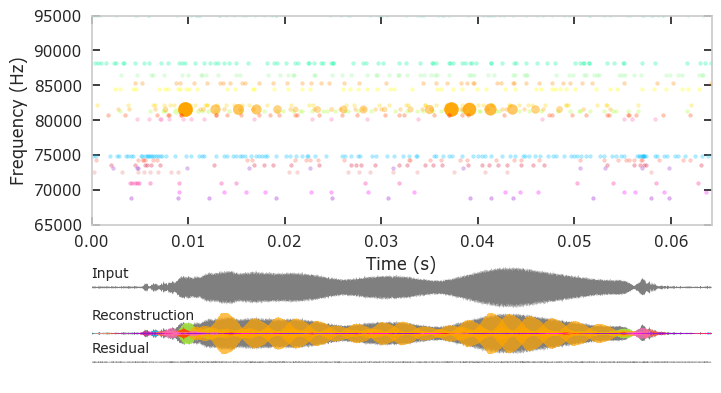

In [ ]:
dictionary = mp.create_dictionary_from_JLD2("kernels_all_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=1000
)

plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left=0.015, right=0.01)


In [285]:
sr = 16000  # Sample rate in Hz

# --- Load dictionary ---
learned_dictionary = mp.create_dictionary_from_JLD2("kernels_15040.jld2")

from scipy.signal import hilbert
from scipy.stats import skew, kurtosis

def modulation_rate(kernel, sr):
    envelope = np.abs(hilbert(kernel))
    envelope_diff = np.diff(envelope)
    rate = np.mean(np.abs(envelope_diff)) * sr
    return rate

# --- Feature extraction ---
def extract_features(kernel, sr):
    duration_ms = len(kernel) / sr * 1000.0

    # Spectrogram
    f, t, Sxx = spectrogram(kernel, fs=sr, nperseg=64, noverlap=32)
    Sxx_mean = np.mean(Sxx, axis=1)
    Sxx_norm = Sxx_mean / (np.sum(Sxx_mean) + 1e-10)

    centroid = np.sum(f * Sxx_norm)
    bandwidth = np.sqrt(np.sum(((f - centroid) ** 2) * Sxx_norm))
    peak_freq = f[np.argmax(Sxx_mean)]
    entropy = -np.sum(Sxx_norm * np.log2(Sxx_norm + 1e-10))

    # Temporal features
    zcr = np.mean(np.abs(np.diff(np.sign(kernel))))
    mod_rate = modulation_rate(kernel, sr)
    skew_val = skew(kernel)
    kurt_val = kurtosis(kernel)

    return [
        centroid, bandwidth, peak_freq, entropy, zcr, mod_rate, skew_val, kurt_val, duration_ms
    ]


features = np.array([extract_features(k.kernel, sr) for k in learned_dictionary])

# --- Scale features ---
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

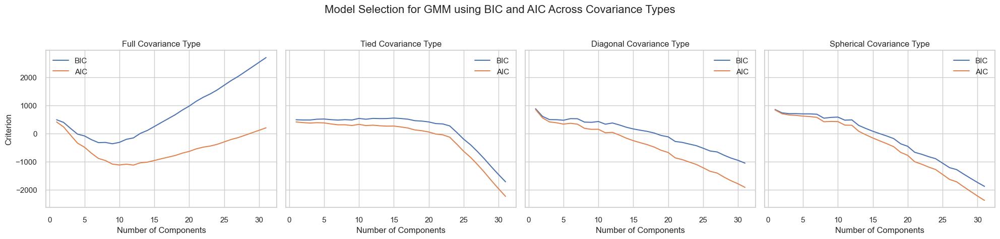

In [286]:
from sklearn.mixture import GaussianMixture

n_components_range = range(1, 32)
covariance_types = ['full', 'tied', 'diag', 'spherical']
title_map = {
    'full': 'Full Covariance Type',
    'tied': 'Tied Covariance Type',
    'diag': 'Diagonal Covariance Type',
    'spherical': 'Spherical Covariance Type'
}

fig, axs = plt.subplots(1, 4, figsize=(20, 5), sharey=True)

for i, cov_type in enumerate(covariance_types):
    bics = []
    aics = []

    for n in n_components_range:
        gmm = GaussianMixture(n_components=n, covariance_type=cov_type, random_state=0)
        gmm.fit(features_scaled)
        bics.append(gmm.bic(features_scaled))
        aics.append(gmm.aic(features_scaled))

    axs[i].plot(n_components_range, bics, label='BIC')
    axs[i].plot(n_components_range, aics, label='AIC')
    axs[i].set_title(title_map[cov_type])
    axs[i].set_xlabel('Number of Components')
    if i == 0:
        axs[i].set_ylabel('Criterion')
    axs[i].legend()

fig.suptitle('Model Selection for GMM using BIC and AIC Across Covariance Types', fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

C:\Users\alexa\AppData\Local\Temp\ipykernel_19804\3979875726.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap('tab10')  # Up to 10 distinct colors; change if n_clusters > 10


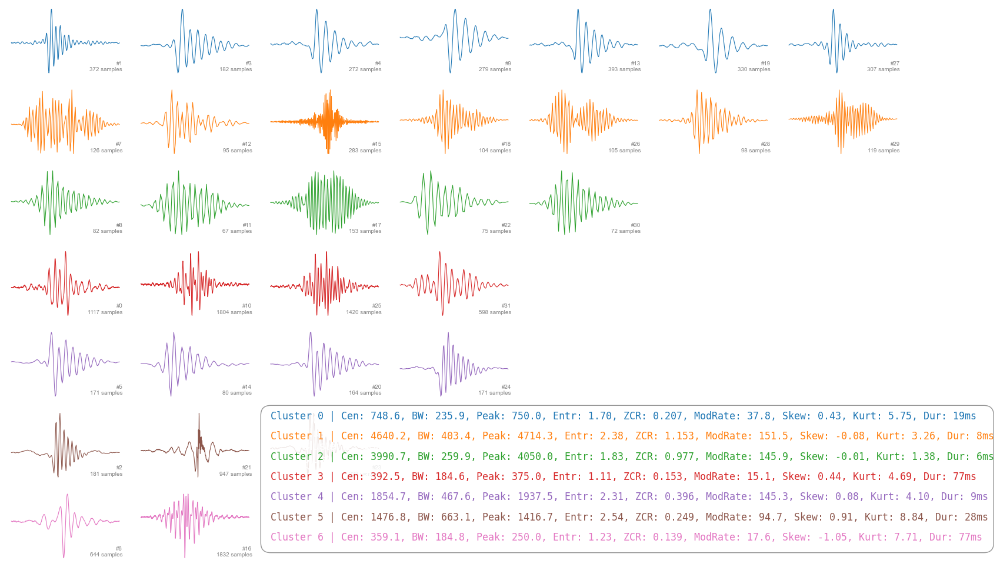

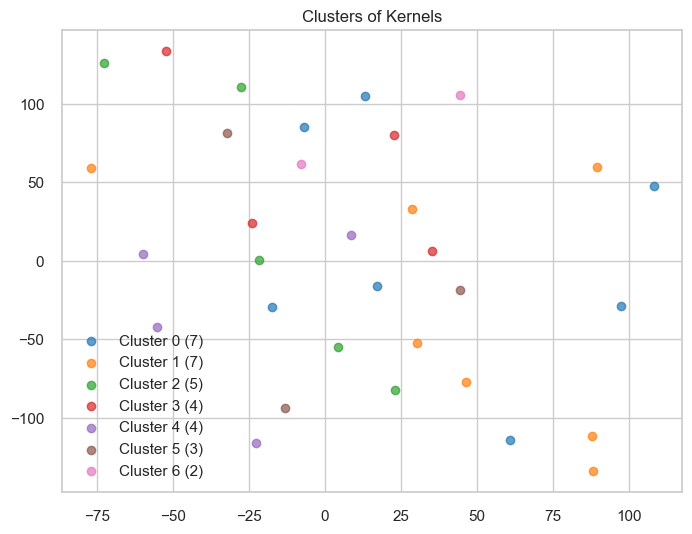

Cluster 0 | Cen: 748.6, BW: 235.9, Peak: 750.0, Entr: 1.70, ZCR: 0.207, ModRate: 37.8, Skew: 0.43, Kurt: 5.75, Dur: 19ms
Cluster 1 | Cen: 4640.2, BW: 403.4, Peak: 4714.3, Entr: 2.38, ZCR: 1.153, ModRate: 151.5, Skew: -0.08, Kurt: 3.26, Dur: 8ms
Cluster 2 | Cen: 3990.7, BW: 259.9, Peak: 4050.0, Entr: 1.83, ZCR: 0.977, ModRate: 145.9, Skew: -0.01, Kurt: 1.38, Dur: 6ms
Cluster 3 | Cen: 392.5, BW: 184.6, Peak: 375.0, Entr: 1.11, ZCR: 0.153, ModRate: 15.1, Skew: 0.44, Kurt: 4.69, Dur: 77ms
Cluster 4 | Cen: 1854.7, BW: 467.6, Peak: 1937.5, Entr: 2.31, ZCR: 0.396, ModRate: 145.3, Skew: 0.08, Kurt: 4.10, Dur: 9ms
Cluster 5 | Cen: 1476.8, BW: 663.1, Peak: 1416.7, Entr: 2.54, ZCR: 0.249, ModRate: 94.7, Skew: 0.91, Kurt: 8.84, Dur: 28ms
Cluster 6 | Cen: 359.1, BW: 184.8, Peak: 250.0, Entr: 1.23, ZCR: 0.139, ModRate: 17.6, Skew: -1.05, Kurt: 7.71, Dur: 77ms


In [288]:
from matplotlib.cm import get_cmap

n_clusters = 7
gmm = GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=0)
labels = gmm.fit_predict(features_scaled)


from collections import Counter
cluster_sizes = Counter(labels)
sorted_clusters = [cluster for cluster, _ in cluster_sizes.most_common()]
cluster_order = {old: new for new, old in enumerate(sorted_clusters)}
sorted_labels = np.array([cluster_order[l] for l in labels])

# --- Choose colors for clusters ---
cmap = get_cmap('tab10')  # Up to 10 distinct colors; change if n_clusters > 10
cluster_colors = [cmap(i % 10) for i in range(n_clusters)]

# --- Compute cluster-wise mean spectral features ---
cluster_feature_means = np.zeros((n_clusters, features.shape[1]))
for new_cluster_id in range(n_clusters):
    old_cluster_id = sorted_clusters[new_cluster_id]
    idxs = np.where(labels == old_cluster_id)[0]
    cluster_feature_means[new_cluster_id] = features[idxs].mean(axis=0)

# --- Helper to format features for display ---
def format_features(feat_array):
    # Select a few meaningful features and format nicely
    centroid, bandwidth, peak_freq, entropy_val, zcr, mod_rate, skew_val, kurt_val, duration_ms = feat_array
    return (f"Cen: {centroid:.1f}\nBW: {bandwidth:.1f}\nPeak: {peak_freq:.1f}\n"
            f"Entr: {entropy_val:.2f}\nZCR: {zcr:.3f}\nModRate: {mod_rate:.1f}\n"
            f"Skew: {skew_val:.2f}\nKurt: {kurt_val:.2f}\nDur(ms): {duration_ms:.0f}")

# --- Plotting kernels per cluster with spectral features ---
max_examples = max([np.sum(labels == cid) for cid in sorted_clusters])
fig, axs = plt.subplots(n_clusters, max_examples, figsize=(max_examples * 1.8 + 3, n_clusters * 1.4))

# Make sure axs is 2D array for consistent indexing
if n_clusters == 1:
    axs = np.expand_dims(axs, axis=0)
if max_examples == 1:
    axs = np.expand_dims(axs, axis=1)

for new_cluster_id in range(n_clusters):
    old_cluster_id = sorted_clusters[new_cluster_id]
    idxs = np.where(labels == old_cluster_id)[0]

    for j in range(max_examples):
        ax = axs[new_cluster_id, j]
        ax.axis("off")
        ax.set_facecolor('white')  # white bg for text readability

        if j < len(idxs):
            idx = idxs[j]
            kernel = learned_dictionary[idx].kernel
            kernel_length = len(kernel)

            # Plot kernel waveform with cluster color
            ax.plot(kernel, linewidth=0.8, color=cluster_colors[new_cluster_id])

            # Show spectral features as text box inside plot (top-left corner)
            # ax.text(0.02, 0.95, format_features(features[idx]),
            #         fontsize=7, color='black', transform=ax.transAxes,
            #         verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', pad=1))

            # Also show kernel index and length at bottom right
            ax.text(0.98, 0.05, f"#{idx}\n{kernel_length} samples",
                    fontsize=7, color='gray', transform=ax.transAxes,
                    verticalalignment='bottom', horizontalalignment='right')

    # Cluster label with average spectral features on the left, rotated vertically
    cluster_label_ax = axs[new_cluster_id, 0]
    cluster_label_ax.set_ylabel(
        f"Cluster {new_cluster_id}\n(n={len(idxs)})\n\nAvg Features:\n{format_features(cluster_feature_means[new_cluster_id])}",
        rotation=0, labelpad=80, va='center', fontsize=8, color=cluster_colors[new_cluster_id]
    )

plt.tight_layout()

# --- t-SNE visualization with cluster colors ---
plt.figure(figsize=(8, 6))
for cluster_id in range(n_clusters):
    idxs = np.where(sorted_labels == cluster_id)[0]
    plt.scatter(*embedding[idxs].T, label=f"Cluster {cluster_id} ({len(idxs)})", alpha=0.7, color=cluster_colors[cluster_id])
plt.legend()
plt.title("Clusters of Kernels")
# --- Compose legend text with average features per cluster ---
# --- Compose colored legend lines ---
legend_lines = []
for new_cluster_id in range(n_clusters):
    avg_feats = cluster_feature_means[new_cluster_id]
    stats_str = (f"Cluster {new_cluster_id} | Cen: {avg_feats[0]:.1f}, BW: {avg_feats[1]:.1f}, "
                 f"Peak: {avg_feats[2]:.1f}, Entr: {avg_feats[3]:.2f}, ZCR: {avg_feats[4]:.3f}, "
                 f"ModRate: {avg_feats[5]:.1f}, Skew: {avg_feats[6]:.2f}, Kurt: {avg_feats[7]:.2f}, "
                 f"Dur: {avg_feats[8]:.0f}ms")
    legend_lines.append(stats_str)

# --- Legend position and layout ---
legend_x = 0.30
legend_y = 0.05
line_height = 0.035
box_width = 0.3
box_height = line_height * len(legend_lines) + 0.01

# --- Draw background box ---
fig.text(
    legend_x, legend_y,
    "\n         ".join(legend_lines)+"\n\n\n",  
    ha='left', va='bottom',
    bbox=dict(facecolor='white', alpha=0.85, edgecolor='gray', boxstyle='round,pad=0.8'),
    color='white',
    fontsize=15, 
)

# --- Draw colored text lines inside the box ---
for i, (line, color) in enumerate(zip(reversed(legend_lines), reversed(cluster_colors))):
    fig.text(
        legend_x, legend_y + line_height * i,
        line,
        ha='left', va='bottom',
        fontsize=12, family='monospace',
        color=color,
    )

plt.show()

print("\n".join(legend_lines))


In [512]:
from scipy.signal import periodogram
from collections import Counter
from matplotlib.patches import Ellipse

def get_kernel_frequency(kernel, sr):
    """
    Estimate the dominant frequency of a kernel using the periodogram.
    """
    freqs, psd = periodogram(kernel, fs=sr)
    return freqs[np.argmax(psd)]

def plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs):
    """
    Plots original signal, reconstruction, residual, and spike code map.

    Crops first and last 1 ms from the waveform and related data.
    """
    plt.rcParams['font.family'] = 'Verdana'
    
    # Crop waveform
    waveform_cropped = waveform[int(sr * 0.015):-int(sr * 0.01)]
    
    # Reconstruct the signal for the full waveform first
    reconstructed = np.zeros_like(waveform)
    for idx, amp, t in zip(indices, amps, time_idxs):
        k = dictionary[idx].kernel
        t_start = t
        t_end = t + len(k)
        if t_end <= len(reconstructed):
            reconstructed[t_start:t_end] += amp * k
    
    # Crop reconstructed signal
    reconstructed_cropped = reconstructed[int(sr * 0.015):-int(sr * 0.01)]
    
    # Crop residual
    residual_cropped = waveform_cropped - reconstructed_cropped
    
    # Crop time axis
    time_cropped = np.arange(len(waveform_cropped)) / sr
    
    # Filter spikes that are within cropped range
    # Keep spikes where time index is >= ms_samples and < len(waveform) - ms_samples
    valid_spikes = [(i, a, t) for i, a, t in zip(indices, amps, time_idxs) if int(sr * 0.015) <= t < (len(waveform) - int(sr * 0.01))]
    
    # Unzip filtered spikes
    if valid_spikes:
        indices_cropped, amps_cropped, time_idxs_cropped = zip(*valid_spikes)
    else:
        indices_cropped, amps_cropped, time_idxs_cropped = [], [], []
    
    # Adjust spike times relative to cropped start (subtract ms_samples)
    spike_times_cropped = [(t - int(sr * 0.015)) / sr for t in time_idxs_cropped]
    
    # Y-limits for signal plots
    max_amp = max(
        np.max(np.abs(waveform_cropped)),
        np.max(np.abs(reconstructed_cropped)),
        np.max(np.abs(residual_cropped))
    )

    # Compute kernel dominant frequencies
    kernel_freqs = [get_kernel_frequency(k.kernel, sr) for k in dictionary]

    fig, axs = plt.subplots(4, 1, figsize=(10, 8),
                            gridspec_kw={'height_ratios': [5, 1, 1, 1]},
                            sharex=True)

    # --- Spike map with ellipses ---
    axs[0].set_ylabel("Frequency (Hz)")
    axs[0].set_xlabel("Time (s)")
    axs[0].set_xlim([0, len(waveform_cropped) / sr])
    axs[0].tick_params(axis='both', which='both', bottom=True, top=True, left=True, right=True, labelbottom=True, labelleft=True, direction='in')
    axs[0].grid(False)
    axs[0].set_ylim(bottom=65000, top=90000)
    spike_freqs = [kernel_freqs[i] for i in indices_cropped]
    amp_sizes = np.array(amps_cropped)
    amp_scaled = (np.abs(amp_sizes) / np.max(np.abs(amp_sizes))) ** 2.5
    size_norm = 7 + 100 * amp_scaled
    alpha_norm = 0.3 + 0.7 * amp_scaled
    # Plot each point individually with its own size and alpha
    for t, f, s, a in zip(spike_times_cropped, spike_freqs, size_norm, alpha_norm):
        axs[0].scatter(t, f, s=s, c='black', alpha=a, linewidths=0.3)

    # Original
    axs[1].plot(time_cropped, waveform_cropped, linewidth=0.1, alpha=0.5, color="black")
    axs[1].set_ylim([-max_amp, max_amp])
    axs[1].axis('off')
    axs[1].text(0, 0.85, "Original Signal",
                transform=axs[1].transAxes, fontsize=10.5, va='top', ha='left')
    
    
    # Reconstruction
    axs[2].plot(time_cropped, reconstructed_cropped, linewidth=0.1, alpha=0.5, color="black")
    axs[2].set_ylim([-max_amp, max_amp])
    axs[2].axis('off')
    axs[2].text(0, 0.85, "Reconstruction",
                transform=axs[2].transAxes, fontsize=10.5, va='top', ha='left')
    
    most_common_kernels = [k for k, _ in Counter(indices_cropped).most_common(6)]
    most_common_kernels = [most_common_kernels[0], most_common_kernels[0], most_common_kernels[4], most_common_kernels[1], most_common_kernels[3], most_common_kernels[2], most_common_kernels[5]]

    colors = ['deepskyblue', 'deepskyblue', 'orange', 'greenyellow', 'orangered', 'gold', 'royalblue']

    plotted_times = []  # keep track of spike times already plotted
    min_time_separation = int(sr * 0.005)  # minimal separation in samples (e.g., 50 ms)

    for kernel_idx, color in zip(most_common_kernels, colors):
        kernel = dictionary[kernel_idx].kernel
        kernel_length = len(kernel)
        
        # Find all spike indices for this kernel
        kernel_spike_indices = [idx for idx, i in enumerate(indices_cropped) if i == kernel_idx]
        if not kernel_spike_indices:
            continue  # no spikes for this kernel
        
        for spike_idx in kernel_spike_indices:
            current_t = time_idxs_cropped[spike_idx]
            
            # Check time difference with already plotted spikes
            # if all(abs(current_t - pt) > min_time_separation for pt in plotted_times):
            amp = amps_cropped[spike_idx]
            
            # Time axis for the kernel, shifted to the spike time (adjusted to cropped time)
            kernel_time = (np.arange(kernel_length) + (current_t - int(sr * 0.015))) / sr
            
            # Scaled kernel amplitude
            scaled_kernel = amp * kernel
            
            # Plot kernel on axs[2]
            axs[2].plot(kernel_time, scaled_kernel, linewidth=0.3, color=color, alpha=0.7)
            
            plotted_times.append(current_t)
            
            kernel_freq = get_kernel_frequency(kernel, sr)
            time_range = axs[0].get_xlim()
            freq_range = axs[0].get_ylim()
            time_span = time_range[1] - time_range[0]
            freq_span = freq_range[1] - freq_range[0]
            circle_radius = 0.0004 + 0.0009 * amp_scaled[spike_idx]
            circle_height = circle_radius * freq_span / time_span * 2.4
            ellipse = Ellipse(
                xy=((current_t - int(sr * 0.015)) / sr, kernel_freq),
                width=circle_radius,
                height=circle_height,
                facecolor=color,
                edgecolor=color
            )
            axs[0].add_patch(ellipse)
            
            # only one spike per kernel color plotted


    # Residual
    axs[3].plot(time_cropped, residual_cropped, linewidth=0.1, alpha=0.5, color="black")
    axs[3].set_ylim([-max_amp, max_amp])
    axs[3].axis('off')
    axs[3].set_xlabel("Time (s)")
    axs[3].text(0, 0.85, "Residual",
                transform=axs[3].transAxes, fontsize=10.5, va='top', ha='left')

    pos1 = axs[1].get_position()
    pos2 = axs[2].get_position()
    pos3 = axs[3].get_position()

    new_pos1 = [pos1.x0, pos1.y0 - 0.02, pos1.width, pos1.height]
    new_pos2 = [pos2.x0, pos2.y0 + 0.015, pos2.width, pos2.height]
    new_pos3 = [pos3.x0, pos3.y0 + 0.07, pos3.width, pos3.height]

    axs[1].set_position(new_pos1)
    axs[2].set_position(new_pos2)
    axs[3].set_position(new_pos3)

    # plt.tight_layout()
    plt.show()


In [5]:
from scipy.signal import periodogram
from collections import Counter
from sklearn.metrics import mean_squared_error

def get_kernel_frequency(kernel, sr):
    """
    Estimate the dominant frequency of a kernel using the periodogram.
    """
    freqs, psd = periodogram(kernel, fs=sr)
    return freqs[np.argmax(psd)]

def plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left = 0.015, right = 0.01):
    """
    Plots original signal, reconstruction, residual, and spike code map.

    Crops first and last 1 ms from the waveform and related data.
    """
    plt.rcParams['font.family'] = 'Verdana'

    left_crop = int(sr * left)
    right_crop = -int(sr * right)
    
    # Crop waveform
    waveform_cropped = waveform[left_crop:right_crop]
    
    # Reconstruct the signal for the full waveform first
    reconstructed = np.zeros_like(waveform)
    for idx, amp, t in zip(indices, amps, time_idxs):
        k = dictionary[idx].kernel
        t_start = t
        t_end = t + len(k)
        if t_end <= len(reconstructed):
            reconstructed[t_start:t_end] += amp * k
    
    # Crop reconstructed signal
    reconstructed_cropped = reconstructed[left_crop:right_crop]
    
    # Crop residual
    residual_cropped = waveform_cropped - reconstructed_cropped
    
    # Crop time axis
    time_cropped = np.arange(len(waveform_cropped)) / sr
    
    # Filter spikes that are within cropped range
    # Keep spikes where time index is >= ms_samples and < len(waveform) - ms_samples
    valid_spikes = [(i, a, t) for i, a, t in zip(indices, amps, time_idxs) if left_crop <= t < (len(waveform) + right_crop)]
    
    # Unzip filtered spikes
    if valid_spikes:
        indices_cropped, amps_cropped, time_idxs_cropped = zip(*valid_spikes)
    else:
        indices_cropped, amps_cropped, time_idxs_cropped = [], [], []
    
    # Adjust spike times relative to cropped start (subtract ms_samples)
    spike_times_cropped = [(t - left_crop) / sr for t in time_idxs_cropped]
    
    # Y-limits for signal plots
    max_amp = max(
        np.max(np.abs(waveform_cropped)),
        np.max(np.abs(reconstructed_cropped)),
        np.max(np.abs(residual_cropped))
    )

    mse = mean_squared_error(waveform_cropped, reconstructed_cropped)
    print(f"Residual MSE: {mse:.6e}")

    signal_power = np.sum(np.square(waveform_cropped))
    noise_power = np.sum(np.square(waveform_cropped - reconstructed_cropped))

    # Prevent division by zero
    if noise_power == 0:
        snr = float('inf')
    else:
        snr = 10 * np.log10(signal_power / noise_power)

    print(f"Reconstruction SNR: {snr:.2f} dB")

    fig, axs = plt.subplots(4, 1, figsize=(8, 5),
                            gridspec_kw={'height_ratios': [5, 1, 1, 1]},
                            sharex=True)

    # Precompute dominant frequencies
    kernel_freqs = [get_kernel_frequency(k.kernel, sr) for k in dictionary]

    # Prepare color mapping for selected most common kernels
    most_common_kernels = [k for k, _ in Counter(indices_cropped).most_common(20)]
    print(f"Number of distinct kernels in cropped indices: {len(set(indices_cropped))}")
    colors = ['deepskyblue', 'mediumspringgreen', 'turquoise', 'palegreen', 'greenyellow', 'yellow', 'gold', 'orange', 'darkorange', 'orangered', 'tomato', 'crimson', 'coral', 'lightcoral', 'hotpink', 'deeppink', 'fuchsia', 'darkorchid', 'darkviolet', 'blueviolet']

    # Track plotted times and collect data for later spike scatter plotting
    plotted_times = []
    spike_plot_data = []

    
    # Reconstruction
    axs[2].plot(time_cropped, reconstructed_cropped, linewidth=0.1, alpha=0.5, color="black")
    axs[2].set_ylim([-max_amp, max_amp])
    axs[2].axis('off')
    axs[2].text(0, 1.1, "Reconstruction",
                transform=axs[2].transAxes, fontsize=10, va='top', ha='left')

    for kernel_idx, color in zip(most_common_kernels, colors):
        kernel = dictionary[kernel_idx].kernel
        kernel_length = len(kernel)

        # Find all spike indices for this kernel
        kernel_spike_indices = [idx for idx, i in enumerate(indices_cropped) if i == kernel_idx]
        if not kernel_spike_indices:
            continue

        for spike_idx in kernel_spike_indices:
            current_t = time_idxs_cropped[spike_idx]
            amp = amps_cropped[spike_idx]
            amp_scaled_value = (np.abs(amp) / np.max(np.abs(amps_cropped))) ** 2.5

            # Shift kernel time to spike time (adjusted for cropped offset)
            kernel_time = (np.arange(kernel_length) + (current_t - left_crop)) / sr
            scaled_kernel = amp * kernel
            axs[2].plot(kernel_time, scaled_kernel, linewidth=0.3, color=color, alpha=0.7)

            # Collect data for spike map
            spike_time = (current_t - left_crop) / sr
            kernel_freq = kernel_freqs[kernel_idx]
            spike_plot_data.append({
                'time': spike_time,
                'freq': kernel_freq,
                'amp_scaled': amp_scaled_value,
                'color': color
            })

    # --- Now plot spike map using precomputed data ---
    axs[0].set_ylabel("Frequency (Hz)")
    axs[0].set_xlabel("Time (s)")
    axs[0].set_xlim([0, len(waveform_cropped) / sr])
    axs[0].tick_params(axis='both', which='both', bottom=True, top=True, left=True, right=True, labelbottom=True, labelleft=True, direction='in')
    axs[0].grid(False)
    axs[0].set_ylim(bottom=65000, top=90000)

    # --- Now handle unmatched spikes (not in most_common_kernels) ---
    max_kernel_idx = len(kernel_freqs) - 1
    unmatched_spikes = [
        (t, i, a) for i, t, a in zip(indices_cropped, time_idxs_cropped, amps_cropped)
        if (i not in most_common_kernels) and (0 <= i <= max_kernel_idx)
    ]

    for t, i, a in unmatched_spikes:
        spike_time = (t - left_crop) / sr
        freq = kernel_freqs[i]
        amp_scaled_value = (np.abs(a) / np.max(np.abs(amps_cropped))) ** 2.5
        s = 7 + 100 * amp_scaled_value
        alpha = 0.3 + 0.7 * amp_scaled_value
        axs[0].scatter(spike_time, freq, s=s, c='black', alpha=alpha, linewidths=0.3)

    for d in spike_plot_data:
        s = 7 + 100 * d['amp_scaled']
        a = 0.3 + 0.7 * d['amp_scaled']
        axs[0].scatter(d['time'], d['freq'], s=s, c=d['color'], alpha=a, linewidths=0.3, edgecolors=d['color'])
        # time_range = axs[0].get_xlim()
        # freq_range = axs[0].get_ylim()
        # time_span = time_range[1] - time_range[0]
        # freq_span = freq_range[1] - freq_range[0]
        # width = 0.00001 + 0.0005 * a  # use amp_scaled directly if available
        # height = width * 1.5 * freq_span / time_span * 3.5

        # ellipse = Ellipse(
        #     xy=(d['time'], d['freq']),
        #     width=width,
        #     height=height,
        #     facecolor=d['color'],
        #     edgecolor=d['color'],
        #     linewidth=0.3,
        #     alpha=a
        # )
        # axs[0].add_patch(ellipse)

    # Original
    axs[1].plot(time_cropped, waveform_cropped, linewidth=0.1, alpha=0.5, color="black")
    axs[1].set_ylim([-max_amp, max_amp])
    axs[1].axis('off')
    axs[1].text(0, 1, "Input",
                transform=axs[1].transAxes, fontsize=10, va='top', ha='left')
    
    # Residual
    axs[3].plot(time_cropped, residual_cropped, linewidth=0.1, alpha=0.5, color="black")
    axs[3].set_ylim([-max_amp, max_amp])
    axs[3].axis('off')
    axs[3].set_xlabel("Time (s)")
    axs[3].text(0, 0.98, "Residual",
                transform=axs[3].transAxes, fontsize=10, va='top', ha='left')

    pos1 = axs[1].get_position()
    pos2 = axs[2].get_position()
    pos3 = axs[3].get_position()

    new_pos1 = [pos1.x0, pos1.y0 - 0.05, pos1.width, pos1.height]
    new_pos2 = [pos2.x0, pos2.y0 - 0.025, pos2.width, pos2.height]
    new_pos3 = [pos3.x0, pos3.y0 + 0.035, pos3.width, pos3.height]

    axs[1].set_position(new_pos1)
    axs[2].set_position(new_pos2)
    axs[3].set_position(new_pos3)

    # plt.tight_layout()
    plt.show()


Residual MSE: 1.918100e-04
Reconstruction SNR: 20.62 dB
Number of distinct kernels in cropped indices: 13


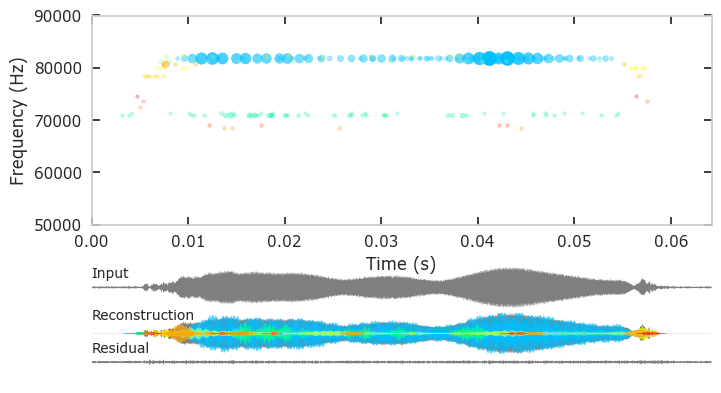

In [709]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=200
)

plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left=0.015, right=0.01)


[np.int64(4929), np.int64(10830), np.int64(10448), np.int64(11256), np.int64(11715), np.int64(6415), np.int64(6044), np.int64(5552), np.int64(9984), np.int64(6846), np.int64(12179), np.int64(8208), np.int64(8617), np.int64(7667), np.int64(12692), np.int64(4751), np.int64(9602), np.int64(7221), np.int64(4530), np.int64(9065), np.int64(7954), np.int64(5308), np.int64(6340), np.int64(5197), np.int64(10699), np.int64(14206), np.int64(13809), np.int64(4434), np.int64(11581), np.int64(13180), np.int64(5752), np.int64(5413), np.int64(10025), np.int64(11188), np.int64(4594), np.int64(4600), np.int64(14137), np.int64(13624), np.int64(4977), np.int64(5840), np.int64(12306), np.int64(10325), np.int64(13128), np.int64(7310), np.int64(6970), np.int64(9386), np.int64(11847), np.int64(6575), np.int64(11448), np.int64(4895), np.int64(4929), np.int64(14230), np.int64(4076), np.int64(12905), np.int64(8459), np.int64(11970), np.int64(4410), np.int64(9543), np.int64(6099), np.int64(4194), np.int64(4483), 

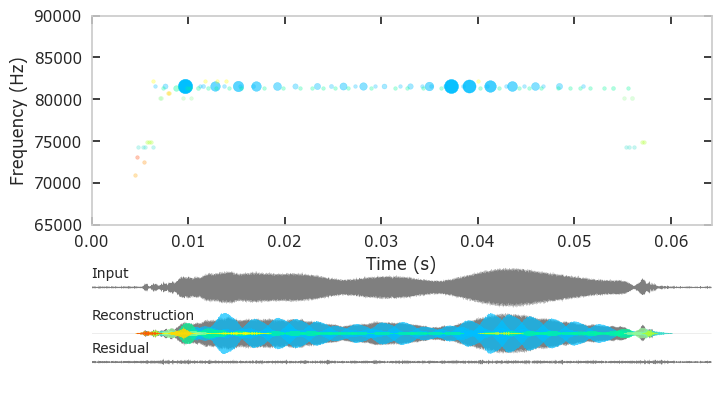

In [6]:
dictionary = mp.create_dictionary_from_JLD2("kernels_all_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=100
)
print(time_idxs)
plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left=0.015, right=0.01)


Residual MSE: 7.743962e-05
Reconstruction SNR: 23.76 dB
Number of distinct kernels in cropped indices: 25


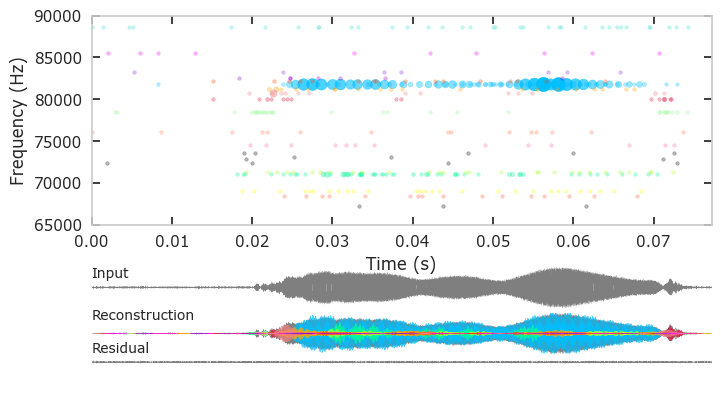

In [24]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
# full_path = "high_rhinolophus_affinis_segments\A000329_YQWWJUBZZV_call_9_0.83-0.90s.wav"
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=500
)
plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left=0, right=0.012)

Residual MSE: 5.877641e-05
Reconstruction SNR: 32.58 dB
Number of distinct kernels in cropped indices: 22


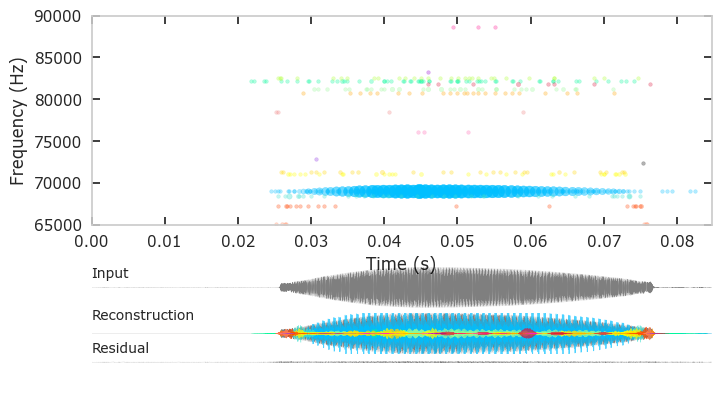

In [25]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A003158_BIJWUEFQKD_call_14_1.36-1.46s.wav")
# full_path = "high_rhinolophus_affinis_segments\A000329_YQWWJUBZZV_call_9_0.83-0.90s.wav"
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=500
)
plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left=0, right=0.012)

In [29]:
print(amps)
full_path = os.path.join("high_rhinolophus_affinis_segments", "A003158_BIJWUEFQKD_call_14_1.36-1.46s.wav")
waveform, sr = sf.read(full_path)
print(np.linalg.norm(waveform), np.max(np.abs(waveform)))


[np.float64(-6.472328866089092), np.float64(-7.077725079968712), np.float64(-6.793407989310373), np.float64(-6.777895798326723), np.float64(-6.694543252193704), np.float64(-6.687727661343866), np.float64(-6.628131243962117), np.float64(-6.559960447914228), np.float64(-6.737589918089024), np.float64(-6.770188011318391), np.float64(-6.705968064387543), np.float64(-6.621962983597441), np.float64(-6.554190408084098), np.float64(-6.49389289984029), np.float64(-6.446588541794079), np.float64(-6.398494058940207), np.float64(-6.389108688866505), np.float64(-6.429192914501724), np.float64(-6.3603310150675), np.float64(-6.292575413857016), np.float64(-6.2658905831927925), np.float64(-6.3056340484866915), np.float64(-6.197185980960989), np.float64(-6.058245879487292), np.float64(-5.974310648849078), np.float64(-5.882765799370682), np.float64(-5.846101418567452), np.float64(-5.684767626023644), np.float64(-5.615994043762615), np.float64(-5.465340996700276), np.float64(-5.447532361046954), np.float

Residual MSE: 3.786797e-07
Reconstruction SNR: 13.06 dB
Number of distinct kernels in cropped indices: 29


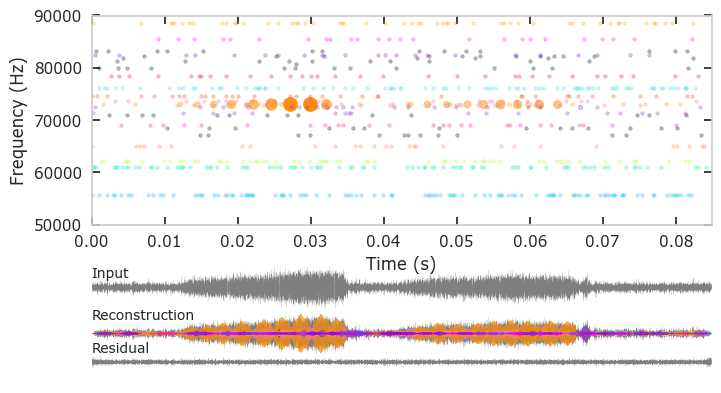

In [705]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
full_path = "high_rhinolophus_affinis_segments\A000325_PSWGVNESEJ_call_3_0.45-0.53s.wav"
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=1000
)

plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left=0, right=0.0001)


Residual MSE: 1.349492e-02
Reconstruction SNR: 14.41 dB
Number of distinct kernels in cropped indices: 27


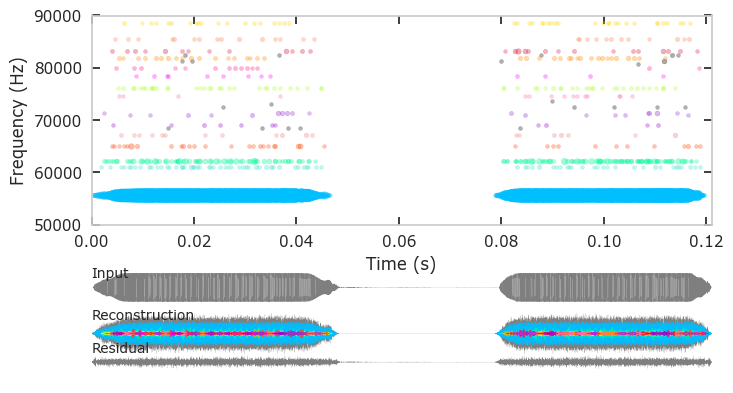

In [715]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
full_path = "high_rhinolophus_pearsonii_segments\A002998_TPRSYOZJXI_call_1_0.03-0.17s.wav"
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=2000
)

plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs)


Residual MSE: 5.636928e-04
Reconstruction SNR: 24.53 dB
Number of distinct kernels in cropped indices: 23


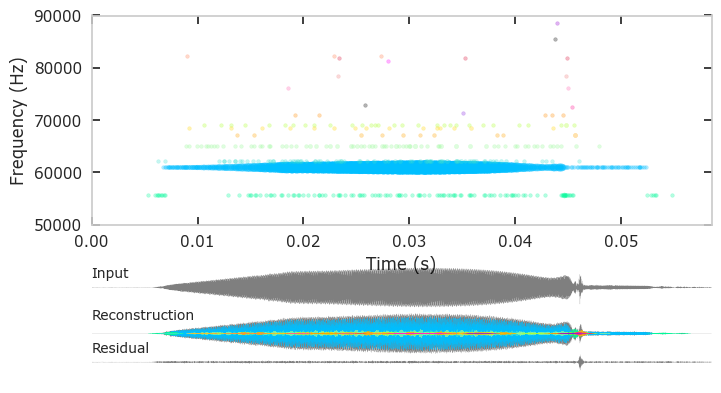

In [714]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
full_path = "high_rhinolophus_pearsonii_segments\A002116_GCHOQAHHQG_call_7_0.66-0.73s.wav"
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=1000
)

plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left=0, right=0.003)


Residual MSE: 2.382121e-03
Reconstruction SNR: 10.20 dB
Number of distinct kernels in cropped indices: 7


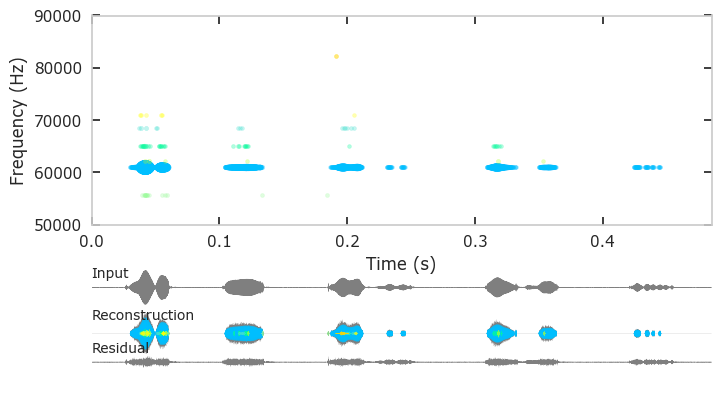

In [713]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A001704_AUAURBYMPI_call_19_3.88-3.97s.wav")
full_path = "high_rhinolophus_pearsonii_segments\A005650_DMJSHXANMI_call_16_3.35-3.85s.wav"
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=1000
)

plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs)


In [ ]:
dictionary = mp.create_dictionary_from_JLD2("kernels_high_400_10000.jld2")
# csv_path = "kernel_activations_per_file.csv"
# activation_counts = load_activation_counts_from_csv(csv_path)
# sorted_indices = np.argsort(-activation_counts)
# sorted_dictionary = [dictionary[i] for i in sorted_indices]
filename = random.choice([
    f for f in os.listdir("high_rhinolophus_affinis_segments") if f.endswith('.wav')
])
full_path = os.path.join("high_rhinolophus_affinis_segments", "A002078_UVQZGDDVIY_call_1_0.00-0.08s.wav")
waveform, sr = sf.read(full_path)
residuals, indices, amps, time_idxs = matching_pursuit_with_full_tracking(
    dictionary, waveform, stop_type='iterations', stop_condition=1783
)

In [31]:
print(len(waveform))
full_path = os.path.join("high_rhinolophus_affinis_segments", "A002078_UVQZGDDVIY_call_1_0.00-0.08s.wav")
waveform, sr = sf.read(full_path)
print(np.linalg.norm(waveform), np.max(np.abs(waveform)))
print([t for t in time_idxs])

19343
28.23379201973599 0.94415283203125
[np.int64(8787), np.int64(8955), np.int64(9123), np.int64(8619), np.int64(8451), np.int64(9271), np.int64(8303), np.int64(9436), np.int64(9604), np.int64(9772), np.int64(9940), np.int64(10108), np.int64(10276), np.int64(10444), np.int64(10612), np.int64(10780), np.int64(8138), np.int64(7970), np.int64(10948), np.int64(11116), np.int64(7802), np.int64(7654), np.int64(11284), np.int64(11452), np.int64(7486), np.int64(11620), np.int64(7318), np.int64(11785), np.int64(11953), np.int64(7170), np.int64(12121), np.int64(12286), np.int64(7002), np.int64(12451), np.int64(12619), np.int64(6834), np.int64(6686), np.int64(12787), np.int64(12952), np.int64(13117), np.int64(6518), np.int64(13285), np.int64(6370), np.int64(13453), np.int64(13621), np.int64(6222), np.int64(13789), np.int64(6074), np.int64(13937), np.int64(14105), np.int64(5923), np.int64(14256), np.int64(5390), np.int64(14675), np.int64(5792), np.int64(14407), np.int64(9192), np.int64(8224), np

Residual MSE: 1.572592e-03
Reconstruction SNR: 15.02 dB


Number of distinct kernels in cropped indices: 16


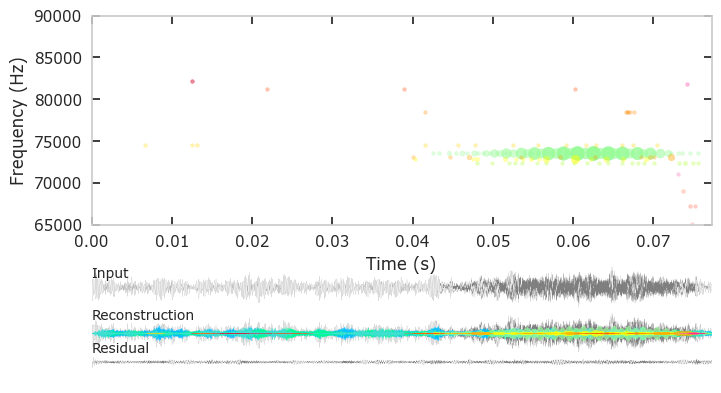

In [11]:
plot_sparse_coding_spike_map(waveform, sr, dictionary, indices, amps, time_idxs, left=0.001, right=0.001)
